In [0]:
from google.colab import auth
auth.authenticate_user()

In [0]:
!gsutil cp  'gs://training-data-2019/Models/model2.h5' .

Copying gs://training-data-2019/Models/model2.h5...
| [1 files][224.5 MiB/224.5 MiB]                                                
Operation completed over 1 objects/224.5 MiB.                                    


In [0]:
!gsutil -m cp -r 'gs://training-data-2019/Damaged-or-not-v1' data .

Copying gs://training-data-2019/Damaged-or-not-v1/.DS_Store...
Copying gs://training-data-2019/Damaged-or-not-v1/Damaged/0.jpg...
Copying gs://training-data-2019/Damaged-or-not-v1/Damaged/101.jpeg...
Copying gs://training-data-2019/Damaged-or-not-v1/Damaged/102.jpeg...
Copying gs://training-data-2019/Damaged-or-not-v1/Damaged/103.jpeg...
Copying gs://training-data-2019/Damaged-or-not-v1/Damaged/1.jpeg...
Copying gs://training-data-2019/Damaged-or-not-v1/Damaged/104.jpg...
Copying gs://training-data-2019/Damaged-or-not-v1/Damaged/105.jpg...
Copying gs://training-data-2019/Damaged-or-not-v1/Damaged/10.jpeg...
Copying gs://training-data-2019/Damaged-or-not-v1/Damaged/100.jpeg...
CommandException: No URLs matched: data
Copying gs://training-data-2019/Damaged-or-not-v1/Damaged/106.jpeg...
Copying gs://training-data-2019/Damaged-or-not-v1/Damaged/107.jpeg...
Copying gs://training-data-2019/Damaged-or-not-v1/Damaged/108.jpeg...
Copying gs://training-data-2019/Damaged-or-not-v1/Damaged/109.jpe

In [0]:
import os
from os.path import join
os.makedirs(join('data', 'train', 'non-damaged'))
os.makedirs(join('data', 'train', 'damaged'))
os.makedirs(join('data', 'validation', 'non-damaged'))
os.makedirs(join('data', 'validation', 'damaged'))
os.makedirs(join('data', 'test', 'non-damaged'))
os.makedirs(join('data', 'test', 'damaged'))

In [0]:
import os
import numpy as np
import shutil
from os.path import join
import cv2

classes = ["damaged", "non-damaged"]

for class_name in classes:
  dirname = "/content/training-data-2019/damaged-or-not-v2-15-1/" + class_name + "/"
  target_filename = "/content/data/"
  print(len(os.listdir(dirname)))

  filenames = os.listdir(dirname)
  print(filenames)
  filenames.sort()
  np.random.shuffle(filenames)
  print(filenames)
  split_1 = int(0.8 * len(filenames))
  split_2 = int(0.9 * len(filenames))
  train_filenames = filenames[:split_1]
  dev_filenames = filenames[split_1:split_2]
  test_filenames = filenames[split_2:]


  for filename in train_filenames:
#       img = cv2.imread(dirname + filename, 0)
#       equ = cv2.equalizeHist(img)
#       cv2.imwrite(dirname + filename)
      shutil.move(dirname + filename,   join(target_filename,"train", class_name ,  filename))

  for filename in dev_filenames:
#       img = cv2.imread(dirname + filename, 0)
#       equ = cv2.equalizeHist(img)
#       cv2.imwrite(dirname + filename)
      shutil.move(dirname + filename,   join(target_filename, "validation", class_name,filename))

  for filename in test_filenames:
#       img = cv2.imread(dirname + filename, 0)
#       equ = cv2.equalizeHist(img)
#       cv2.imwrite(dirname + filename)
      shutil.move(dirname + filename,   join(target_filename, "test",class_name, filename))

    

234
['223.jpg', '66.jpg', '138.jpeg', '233.jpg', '117.jpg', '219.jpeg', '18.jpeg', '31.jpg', '202.jpg', '185.jpeg', '116.jpg', '63.jpeg', '159.jpg', '125.jpeg', '142.jpeg', '83.jpeg', '134.jpg', '7.jpg', '200.jpg', '85.jpeg', '80.jpg', '145.jpg', '55.jpg', '144.jpeg', '121.jpeg', '34.jpeg', '98.jpeg', '17.jpeg', '161.jpeg', '152.jpeg', '64.jpeg', '96.jpeg', '177.jpeg', '154.jpeg', '71.jpeg', '111.jpeg', '169.jpg', '141.jpeg', '180.jpg', '36.jpeg', '174.jpeg', '67.jpeg', '32.jpg', '183.jpeg', '191.jpeg', '95.jpeg', '113.jpg', '132.jpg', '75.jpeg', '184.jpeg', '168.jpeg', '54.jpg', '167.jpeg', '20.jpg', '217.jpg', '110.jpeg', '42.jpg', '51.jpg', '12.jpeg', '208.jpg', '89.jpg', '43.jpeg', '25.jpeg', '101.jpeg', '30.jpg', '104.jpg', '171.jpg', '26.jpeg', '231.jpeg', '59.png', '19.jpg', '221.jpeg', '198.jpeg', '186.jpg', '72.jpeg', '27.jpg', '23.jpg', '146.jpeg', '131.jpg', '90.jpg', '102.jpeg', '220.jpeg', '9.jpg', '149.png', '84.jpeg', '206.jpeg', '112.jpeg', '40.jpg', '35.jpg', '3.jpeg',

In [0]:
dirname1 = "/content/data/validation/non-damaged/"
dirname2 = "/content/data/validation/damaged/"
dirname3 = "/content/data/train/damaged/"
dirname4 = "/content/data/train/non-damaged/"
print(len(os.listdir(dirname1)), len(os.listdir(dirname2)), len(os.listdir(dirname3)),len(os.listdir(dirname4)))

26 23 187 211


In [0]:
from keras import Model
import numpy as np
from keras.preprocessing.image import ImageDataGenerator
from keras.models import Sequential
from keras.layers import Dropout, Flatten, Dense
from keras import applications
from keras.models import load_model
from keras import optimizers
import cv2
import numpy as np

train_data_dir = 'data/train'
validation_data_dir = 'data/validation'
test_data_dir = 'data/test'
model = applications.VGG19(weights = "imagenet", include_top=False, input_shape = (150, 150, 3))
for layer in model.layers[:5]:
    layer.trainable = False
x = model.output
x = Flatten()(x)
x = Dense(1024, activation="relu")(x)
x = Dropout(0.5)(x)
x = Dense(1024, activation="relu")(x)
predictions = Dense(2, activation="sigmoid")(x)

model_final = Model(input = model.input, output = predictions)
model_final.compile(loss = "binary_crossentropy", optimizer = optimizers.SGD(lr=0.0001, momentum=0.9), metrics=["accuracy"])



train_datagen = ImageDataGenerator(
    rescale=1./255,
        rotation_range=30,
        width_shift_range=0.1, 
        height_shift_range=0.1,  
        channel_shift_range=0.1,
        shear_range=0.1,
        zoom_range=0.1,
        horizontal_flip=True)

test_datagen = ImageDataGenerator(rescale=1. / 255)

train_generator = train_datagen.flow_from_directory(
    train_data_dir ,
    target_size=(150, 150),
    batch_size=4,
    class_mode='categorical')
validation_generator = train_datagen.flow_from_directory(
    validation_data_dir ,
    target_size=(150, 150),
    batch_size=4,
    class_mode='categorical')
# model = get_model()
model_final.fit_generator(
    train_generator,
    validation_data=validation_generator,
    validation_steps=10,
    samples_per_epoch=100,
    epochs=50)
model_final.save("model2.h5")



80142336/80134624 [==============================] - 1s 0us/step


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:25: UserWarning: Update your `Model` call to the Keras 2 API: `Model(inputs=Tensor("in..., outputs=Tensor("de...)`


Found 398 images belonging to 2 classes.
Found 49 images belonging to 2 classes.


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:58: UserWarning: Update your `fit_generator` call to the Keras 2 API: `fit_generator(<keras_pre..., validation_data=<keras_pre..., validation_steps=10, epochs=50, steps_per_epoch=25)`


Epoch 1/50
20/25 [=======================>......] - ETA: 2s - loss: 0.7429 - acc: 0.5312

/usr/local/lib/python3.6/dist-packages/PIL/Image.py:872: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


25/25 [==============================] - 10s 400ms/step - loss: 0.7402 - acc: 0.5350 - val_loss: 0.6744 - val_acc: 0.5750
Epoch 2/50
25/25 [==============================] - 4s 180ms/step - loss: 0.6946 - acc: 0.5350 - val_loss: 0.7516 - val_acc: 0.4324
Epoch 3/50
25/25 [==============================] - 4s 160ms/step - loss: 0.7129 - acc: 0.5250 - val_loss: 0.6559 - val_acc: 0.5676
Epoch 4/50
25/25 [==============================] - 5s 197ms/step - loss: 0.6994 - acc: 0.5552 - val_loss: 0.6405 - val_acc: 0.6351
Epoch 5/50
25/25 [==============================] - 4s 159ms/step - loss: 0.6524 - acc: 0.5950 - val_loss: 0.5804 - val_acc: 0.7250
Epoch 6/50
25/25 [==============================] - 4s 157ms/step - loss: 0.6095 - acc: 0.6900 - val_loss: 0.6704 - val_acc: 0.6081
Epoch 7/50
25/25 [==============================] - 4s 160ms/step - loss: 0.6450 - acc: 0.6400 - val_loss: 0.5382 - val_acc: 0.7703
Epoch 8/50
25/25 [==============================] - 4s 159ms/step - loss: 0.5762 - acc

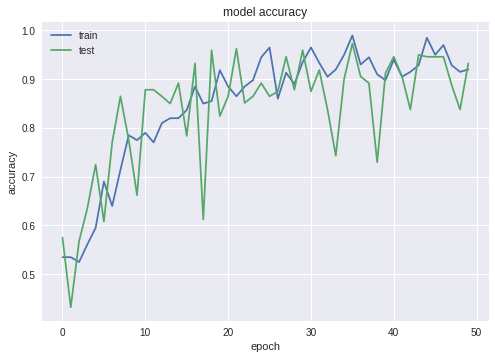

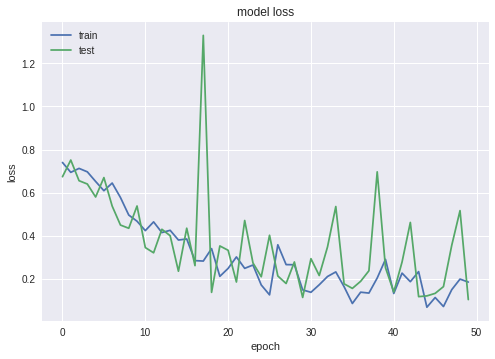

In [0]:
import matplotlib.pyplot as plt

history = model_final.history
plt.plot(history.history['acc'])
plt.plot(history.history['val_acc'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

In [0]:
%matplotlib inline
import matplotlib
from matplotlib import pyplot as plt
import matplotlib.image as mpimg
import cv2
import numpy as np
from keras.preprocessing.image import ImageDataGenerator
from keras.models import Sequential
from keras.layers import Dropout, Flatten, Dense, Conv2D
from keras import applications
from keras.models import load_model
from keras import backend as K
from keras.layers.normalization import BatchNormalization
from keras.preprocessing.image import ImageDataGenerator
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D
from keras.layers import Activation, Dropout, Flatten, Dense
from keras.layers.normalization import BatchNormalization
from keras import backend as K
from keras import models
import tensorflow as tf


import cv2

K.clear_session()

model = load_model("/content/model2.h5")
for file in os.listdir("/content/training-data-2019/damaged-or-not-v2-15-1/damaged_test/"):
  img = cv2.imread('/content/training-data-2019/damaged-or-not-v2-15-1/damaged_test/' + file)
  img = img/255
  img = cv2.resize(img,(150,150))
  img = np.reshape(img,[1,150,150,3])
  predictions = model.predict(img)
  for i, predicted in enumerate(predictions):
    if predicted[0] > 0.25:
        print("bigger than 0.25")
        #assign i to class 1
    else:
        print("smaller than 0.25")
        #assign i to class 0
        
for file in os.listdir("/content/data/test/non-damaged/"):
  img = cv2.imread('/content/data/test/non-damaged/' + file)
  img = img/255
  img = cv2.resize(img,(150,150))
  img = np.reshape(img,[1,150,150,3])
  predictions = model.predict(img)
  for i, predicted in enumerate(predictions):
    if predicted[0] > 0.25:
        print("bigger than 0.25")
        #assign i to class 1
    else:
        print("smaller than 0.25")
        #assign i to class 0


bigger than 0.25
bigger than 0.25
bigger than 0.25
bigger than 0.25
bigger than 0.25
bigger than 0.25
bigger than 0.25
smaller than 0.25
bigger than 0.25
bigger than 0.25
bigger than 0.25
bigger than 0.25
bigger than 0.25
bigger than 0.25
bigger than 0.25
bigger than 0.25
bigger than 0.25
bigger than 0.25
bigger than 0.25
bigger than 0.25
bigger than 0.25
bigger than 0.25


TypeError: ignored

[<tf.Tensor 'block1_conv1/Relu:0' shape=(?, 150, 150, 64) dtype=float32>, <tf.Tensor 'block1_conv2/Relu:0' shape=(?, 150, 150, 64) dtype=float32>, <tf.Tensor 'block1_pool/MaxPool:0' shape=(?, 75, 75, 64) dtype=float32>, <tf.Tensor 'block2_conv1/Relu:0' shape=(?, 75, 75, 128) dtype=float32>, <tf.Tensor 'block2_conv2/Relu:0' shape=(?, 75, 75, 128) dtype=float32>, <tf.Tensor 'block2_pool/MaxPool:0' shape=(?, 37, 37, 128) dtype=float32>, <tf.Tensor 'block3_conv1/Relu:0' shape=(?, 37, 37, 256) dtype=float32>, <tf.Tensor 'block3_conv2/Relu:0' shape=(?, 37, 37, 256) dtype=float32>, <tf.Tensor 'block3_conv3/Relu:0' shape=(?, 37, 37, 256) dtype=float32>, <tf.Tensor 'block3_conv4/Relu:0' shape=(?, 37, 37, 256) dtype=float32>, <tf.Tensor 'block3_pool/MaxPool:0' shape=(?, 18, 18, 256) dtype=float32>, <tf.Tensor 'block4_conv1/Relu:0' shape=(?, 18, 18, 512) dtype=float32>, <tf.Tensor 'block4_conv2/Relu:0' shape=(?, 18, 18, 512) dtype=float32>, <tf.Tensor 'block4_conv3/Relu:0' shape=(?, 18, 18, 512) 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:45: RuntimeWarning: invalid value encountered in true_divide


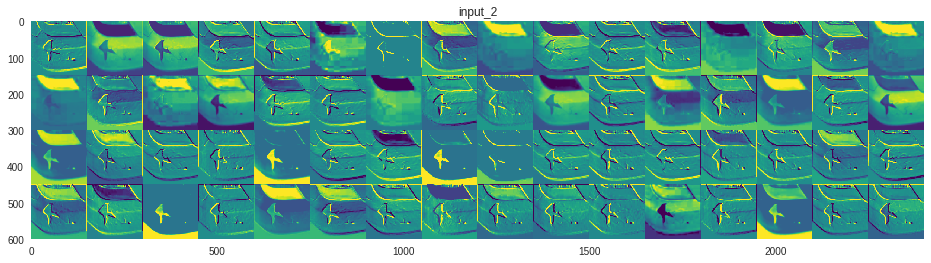

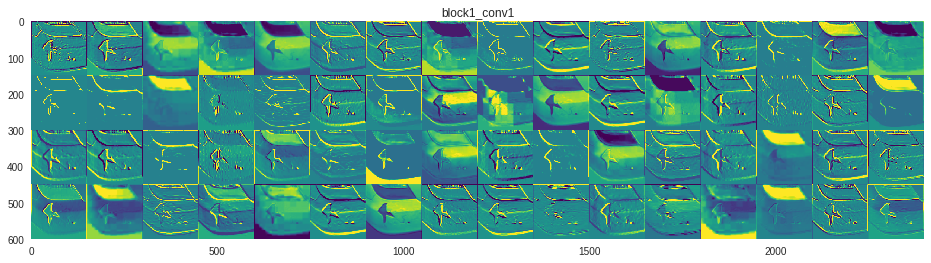

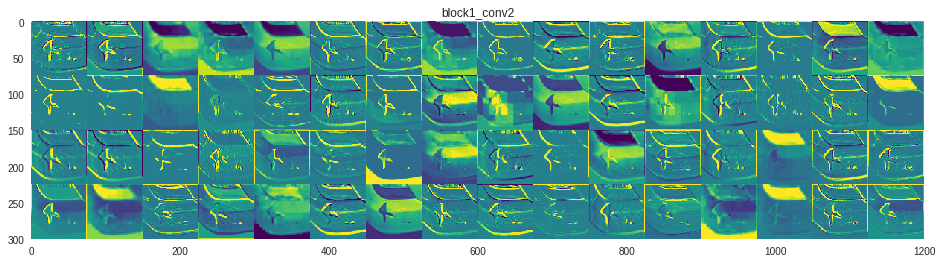

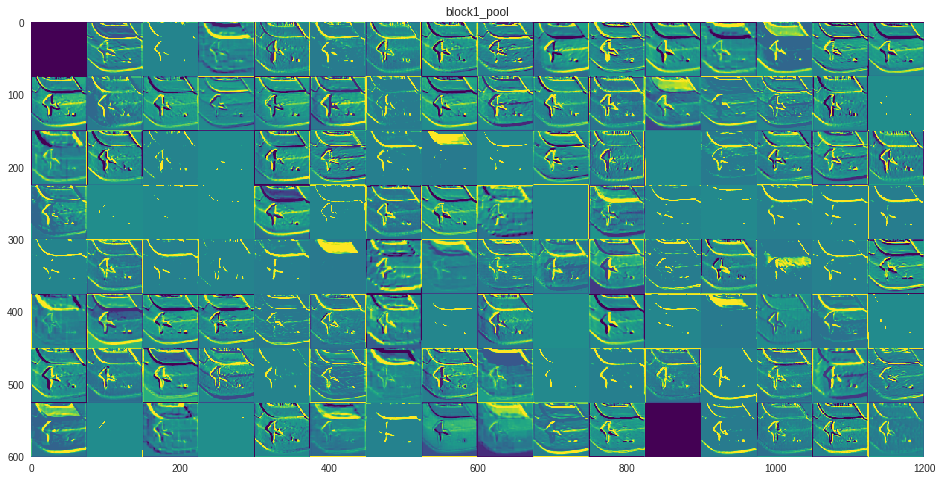

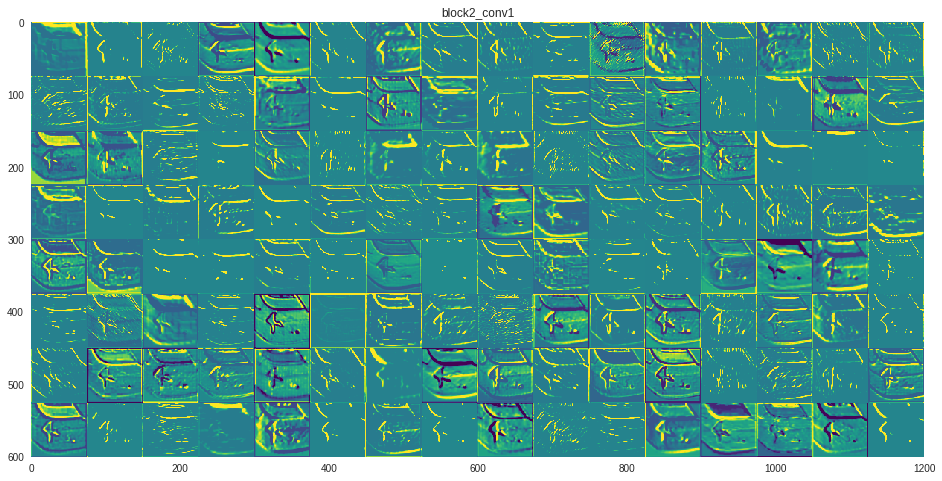

...

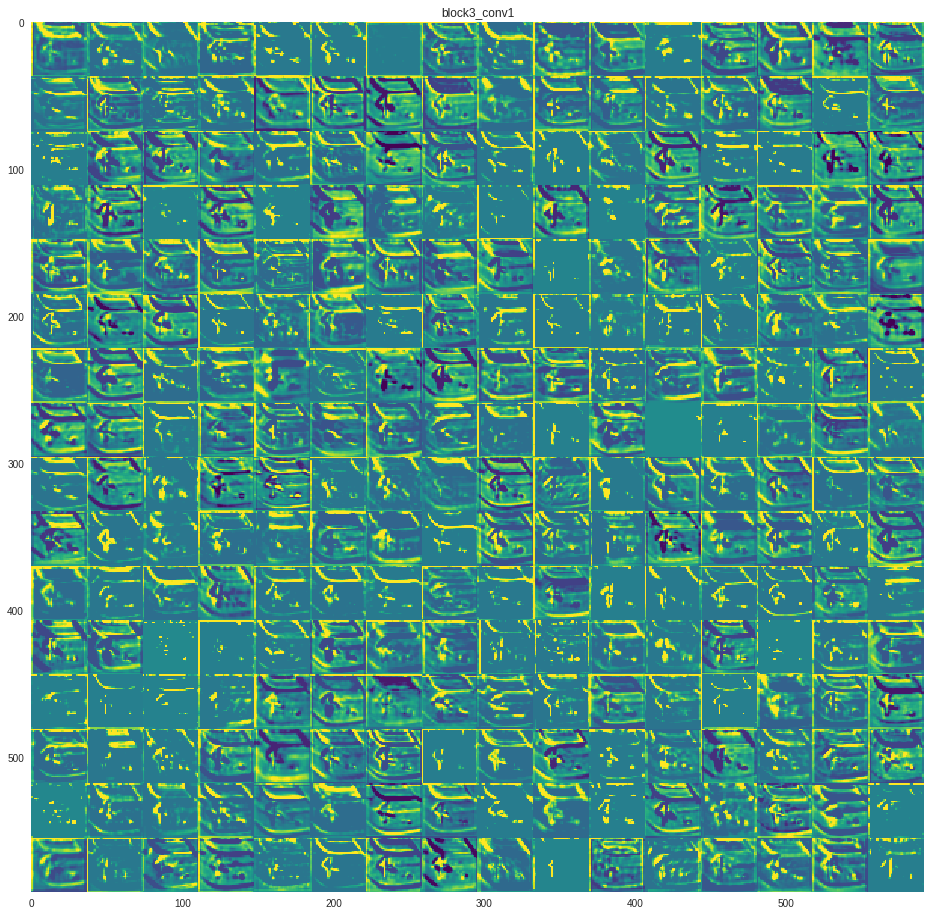

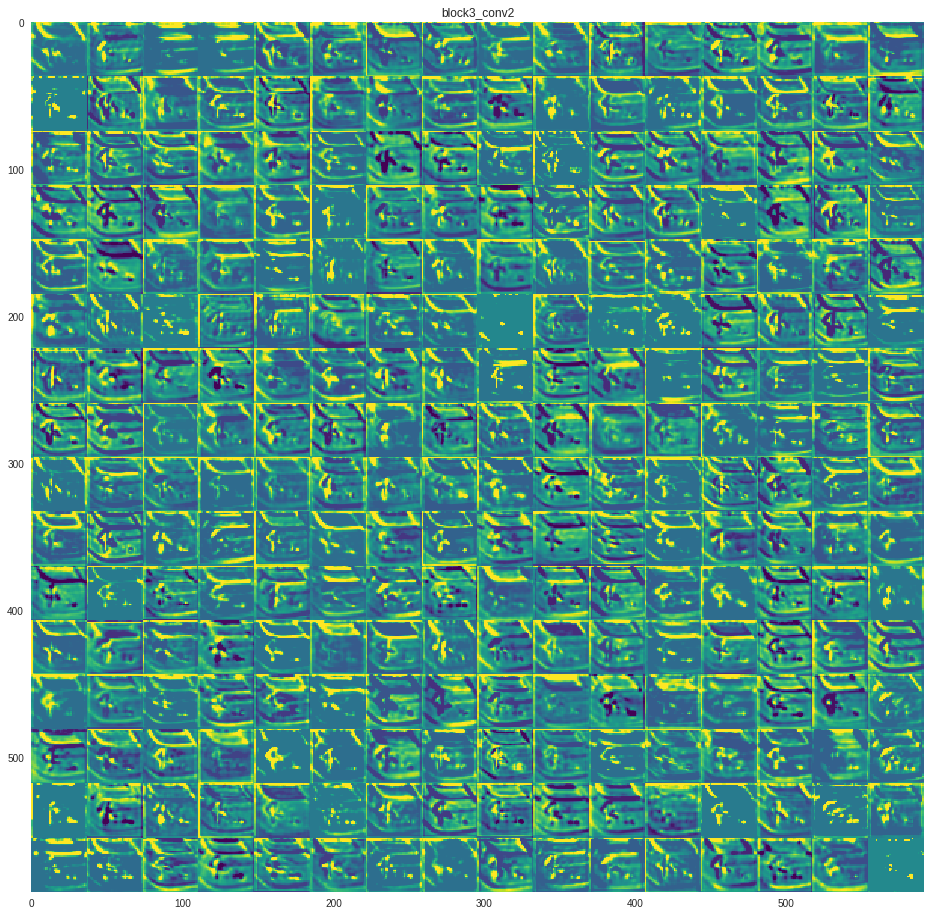

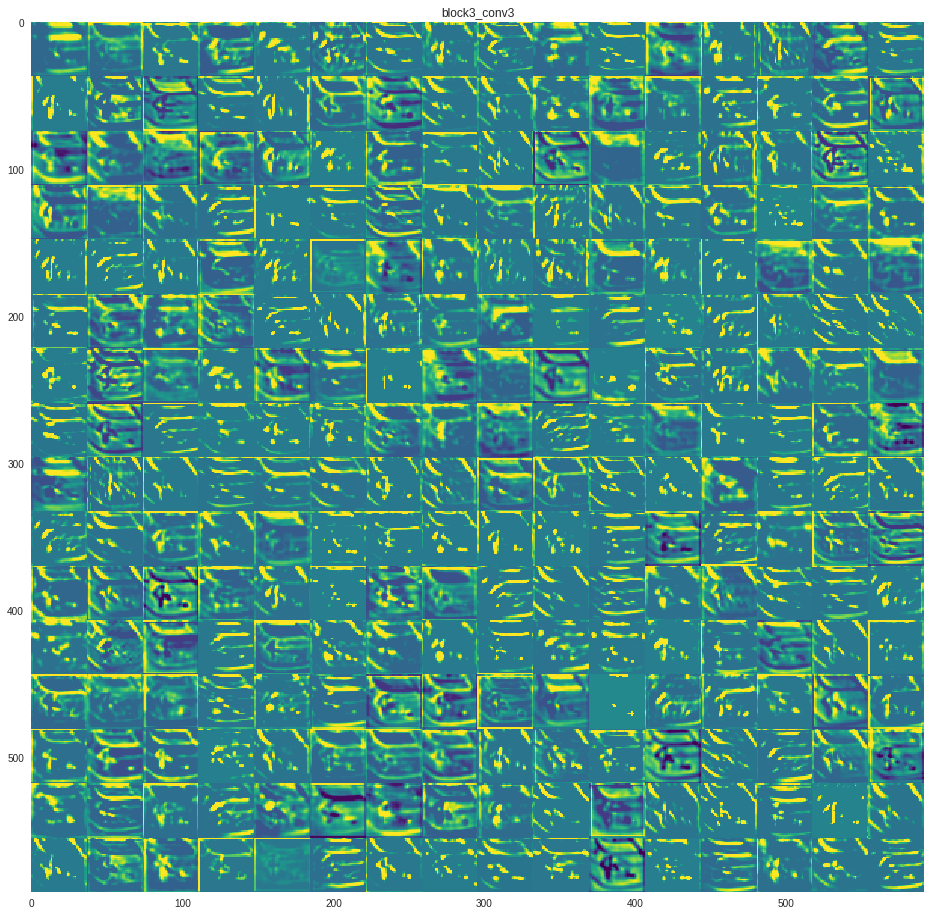

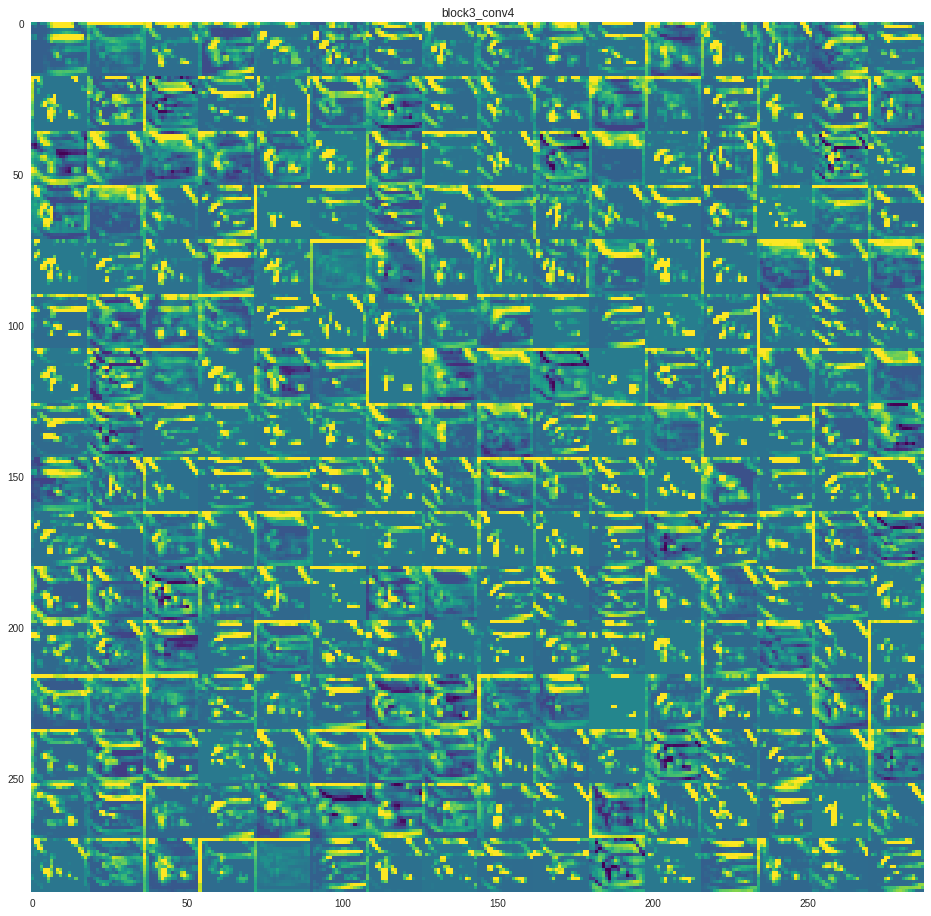

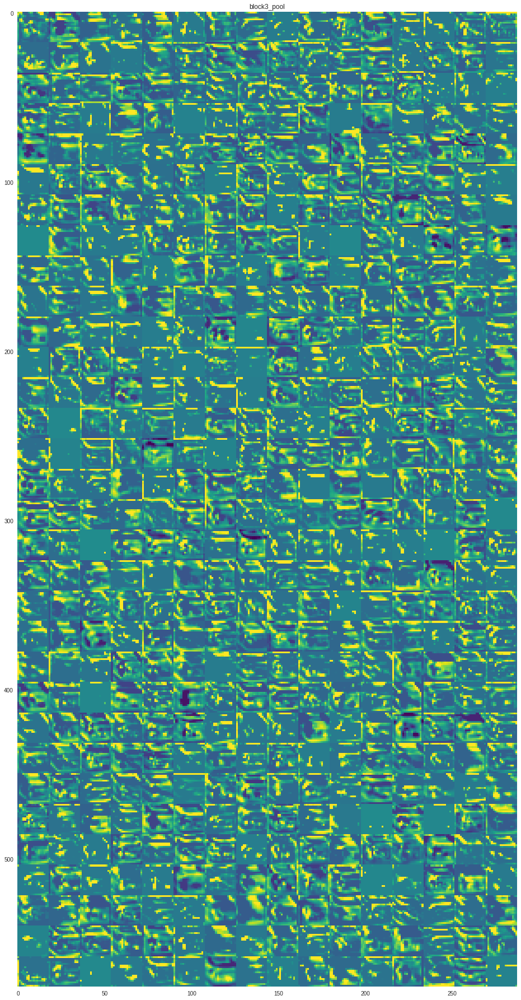

In [0]:
%matplotlib inline
from keras.applications import VGG16
from vis.utils import utils
from keras import activations
from vis.visualization import visualize_activation
from matplotlib import pyplot as plt
K.clear_session()

model_test = load_model("model2.h5")

from vis.visualization import get_num_filters

layer_outputs = [layer.output for layer in model_test.layers[1:]]
print(layer_outputs)

activation_model = models.Model(inputs=model_test.input, outputs=layer_outputs) # Creates a model that will return these outputs, given the model input

img = cv2.imread('/content/training-data-2019/damaged-or-not-v2-15-1/damaged_test/100.jpg')
img = img/255
img = cv2.resize(img,(150,150))
img_tensor = np.reshape(img,[1, 150,150,3])
activations = activation_model.predict(img_tensor)


first_layer_activation = activations[0]
print(first_layer_activation.shape)

layer_names = []
for layer in model.layers[:12]:
    layer_names.append(layer.name) # Names of the layers, so you can have them as part of your plot
    
images_per_row = 16

for layer_name, layer_activation in zip(layer_names, activations): # Displays the feature maps
    n_features = layer_activation.shape[-1] # Number of features in the feature map
    size = layer_activation.shape[1] #The feature map has shape (1, size, size, n_features).
    n_cols = n_features // images_per_row # Tiles the activation channels in this matrix
    display_grid = np.zeros((size * n_cols, images_per_row * size))
    for col in range(n_cols): # Tiles each filter into a big horizontal grid
        for row in range(images_per_row):
            channel_image = layer_activation[0,
                                             :, :,
                                             col * images_per_row + row]
            channel_image -= channel_image.mean() # Post-processes the feature to make it visually palatable
            channel_image /= channel_image.std()
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            display_grid[col * size : (col + 1) * size, # Displays the grid
                         row * size : (row + 1) * size] = channel_image
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1],
                        scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')



In [0]:

import time
from keras.preprocessing.image import save_img
from keras.applications import vgg16
from keras import backend as K
from keras.models import load_model
import numpy as np

# dimensions of the generated pictures for each filter.
img_width = 128
img_height = 128

# the name of the layer we want to visualize
# (see model definition at keras/applications/vgg16.py)
layer_name = 'block5_conv3'

# util function to convert a tensor into a valid image


def deprocess_image(x):
    # normalize tensor: center on 0., ensure std is 0.1
    x -= x.mean()
    x /= (x.std() + K.epsilon())
    x *= 0.1

    # clip to [0, 1]
    x += 0.5
    x = np.clip(x, 0, 1)

    # convert to RGB array
    x *= 255
    if K.image_data_format() == 'channels_first':
        x = x.transpose((1, 2, 0))
    x = np.clip(x, 0, 255).astype('uint8')
    return x


# build the VGG16 network with ImageNet weights
model = load_model("model2.h5")
print('Model loaded.')

model.summary()

# this is the placeholder for the input images
input_img = model.input

# get the symbolic outputs of each "key" layer (we gave them unique names).
layer_dict = dict([(layer.name, layer) for layer in model.layers[1:]])


def normalize(x):
    # utility function to normalize a tensor by its L2 norm
    return x / (K.sqrt(K.mean(K.square(x))) + K.epsilon())


kept_filters = []
for filter_index in range(200):
    # we only scan through the first 200 filters,
    # but there are actually 512 of them
    print('Processing filter %d' % filter_index)
    start_time = time.time()

    # we build a loss function that maximizes the activation
    # of the nth filter of the layer considered
    layer_output = layer_dict[layer_name].output
    if K.image_data_format() == 'channels_first':
        loss = K.mean(layer_output[:, filter_index, :, :])
    else:
        loss = K.mean(layer_output[:, :, :, filter_index])

    # we compute the gradient of the input picture wrt this loss
    grads = K.gradients(loss, input_img)[0]

    # normalization trick: we normalize the gradient
    grads = normalize(grads)

    # this function returns the loss and grads given the input picture
    iterate = K.function([input_img], [loss, grads])

    # step size for gradient ascent
    step = 1.

    # we start from a gray image with some random noise
    input_img_data = np.random.random((1, img_width, img_height, 3))
    input_img_data = (input_img_data - 0.5) * 20 + 128

    # we run gradient ascent for 20 steps
    for i in range(20):
        loss_value, grads_value = iterate([input_img_data])
        input_img_data += grads_value * step

        print('Current loss value:', loss_value)
        if loss_value <= 0.:
            # some filters get stuck to 0, we can skip them
            break

    # decode the resulting input image
    if loss_value > 0:
        img = deprocess_image(input_img_data[0])
        kept_filters.append((img, loss_value))
    end_time = time.time()
    print('Filter %d processed in %ds' % (filter_index, end_time - start_time))

# we will stich the best 64 filters on a 8 x 8 grid.
n = 8

# the filters that have the highest loss are assumed to be better-looking.
# we will only keep the top 64 filters.
kept_filters.sort(key=lambda x: x[1], reverse=True)
kept_filters = kept_filters[:n * n]

# build a black picture with enough space for
# our 8 x 8 filters of size 128 x 128, with a 5px margin in between
margin = 5
width = n * img_width + (n - 1) * margin
height = n * img_height + (n - 1) * margin
stitched_filters = np.zeros((width, height, 3))

# fill the picture with our saved filters
for i in range(n):
    for j in range(n):
        img, loss = kept_filters[i * n + j]
        width_margin = (img_width + margin) * i
        height_margin = (img_height + margin) * j
        stitched_filters[
            width_margin: width_margin + img_width,
            height_margin: height_margin + img_height, :] = img

# save the result to disk
save_img('stitched_filters_%dx%d.png' % (n, n), stitched_filters)


Model loaded.
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         (None, 150, 150, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 150, 150, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 150, 150, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 75, 75, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 75, 75, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 75, 75, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 37, 37, 128)       0      

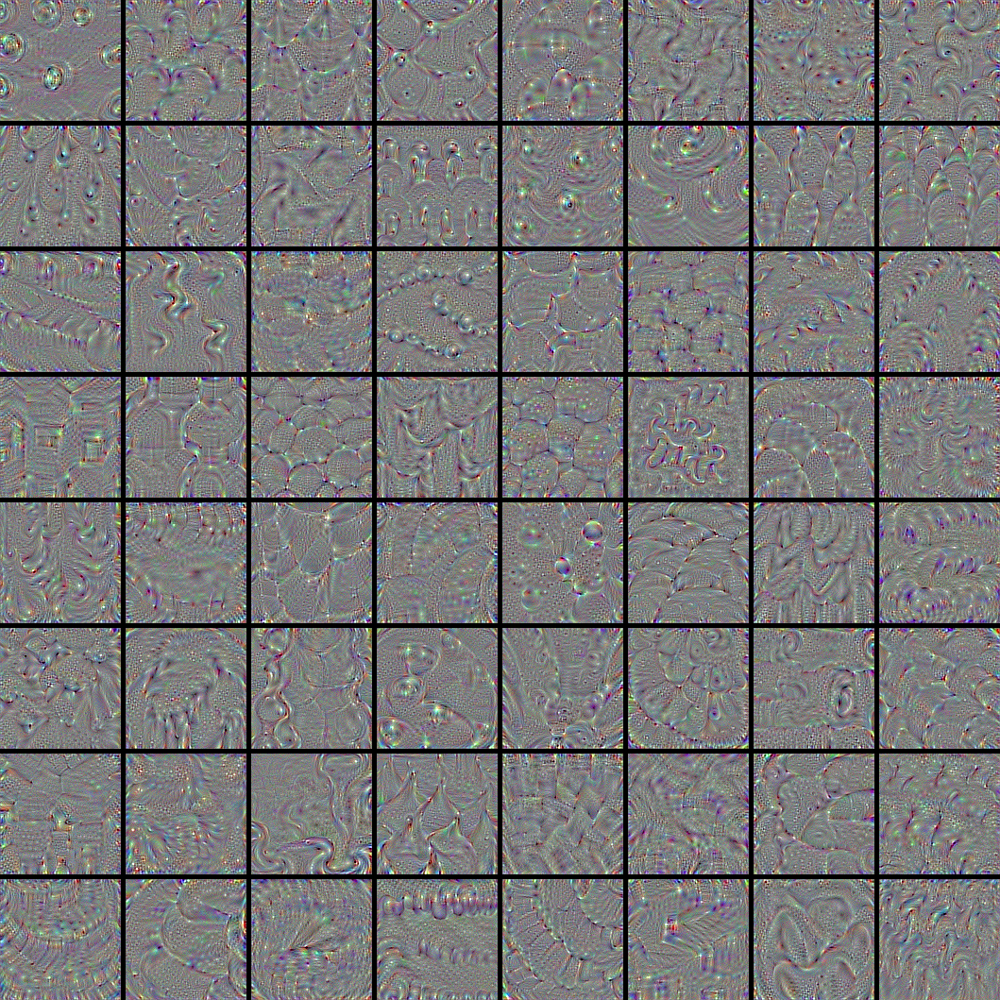

In [0]:
from IPython.display import Image, display
display(Image('/content/stitched_filters_8x8.png'))

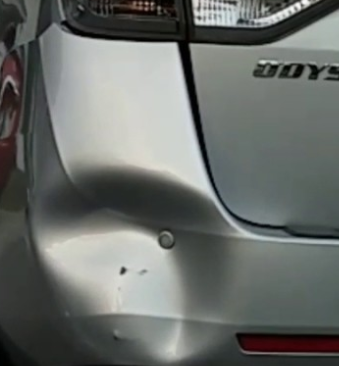

[[0.6493022 0.3112825]]
damaged


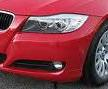

[[0.00460172 0.99628204]]
not


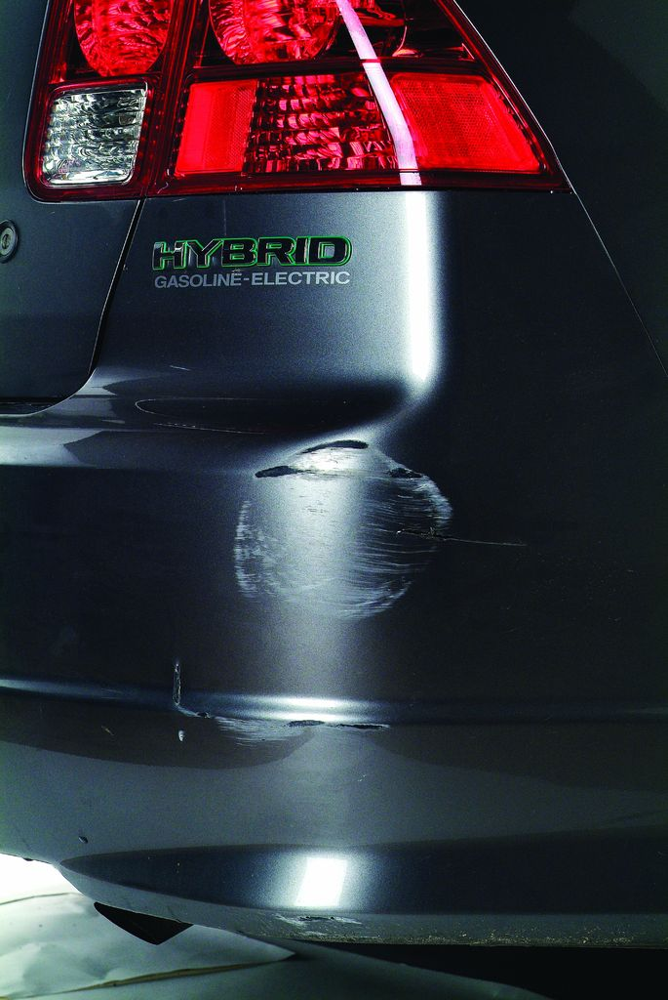

[[0.525787  0.4981209]]
damaged


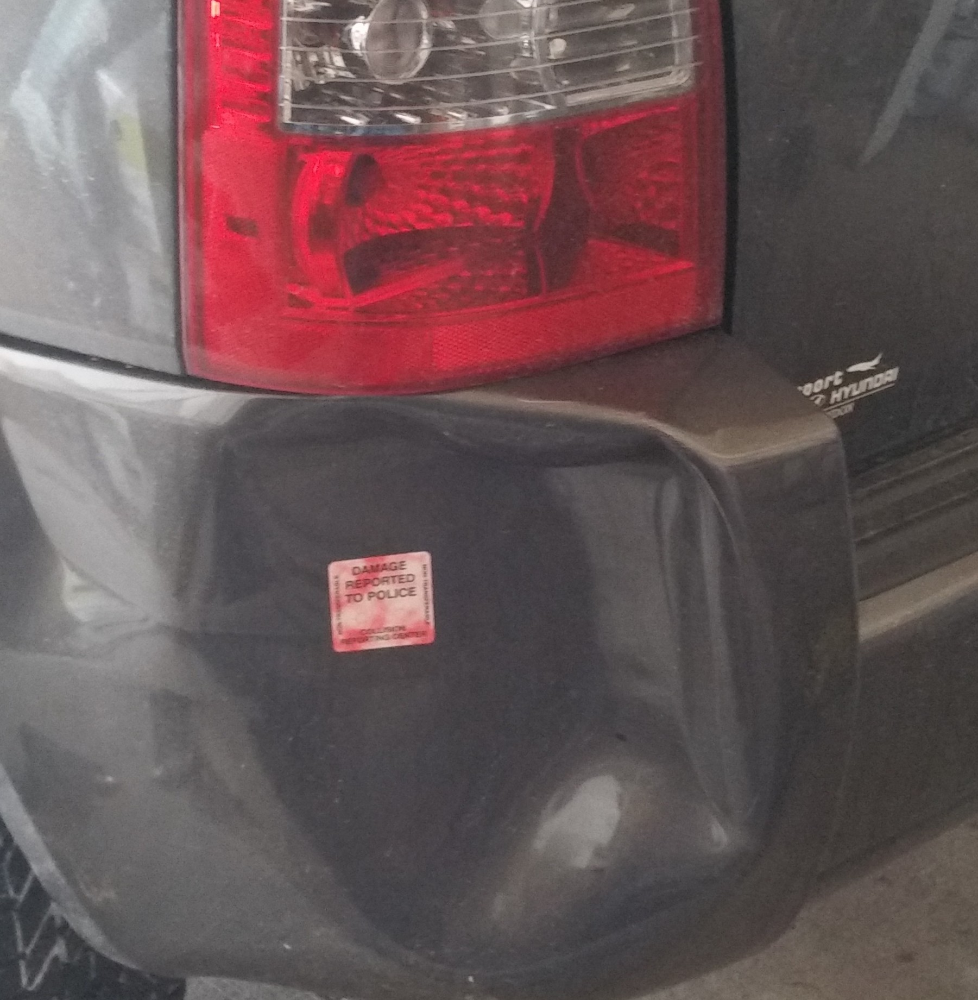

[[0.2014915 0.7783707]]
not


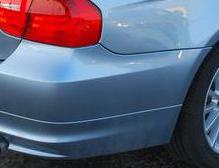

[[0.041527  0.9576805]]
not


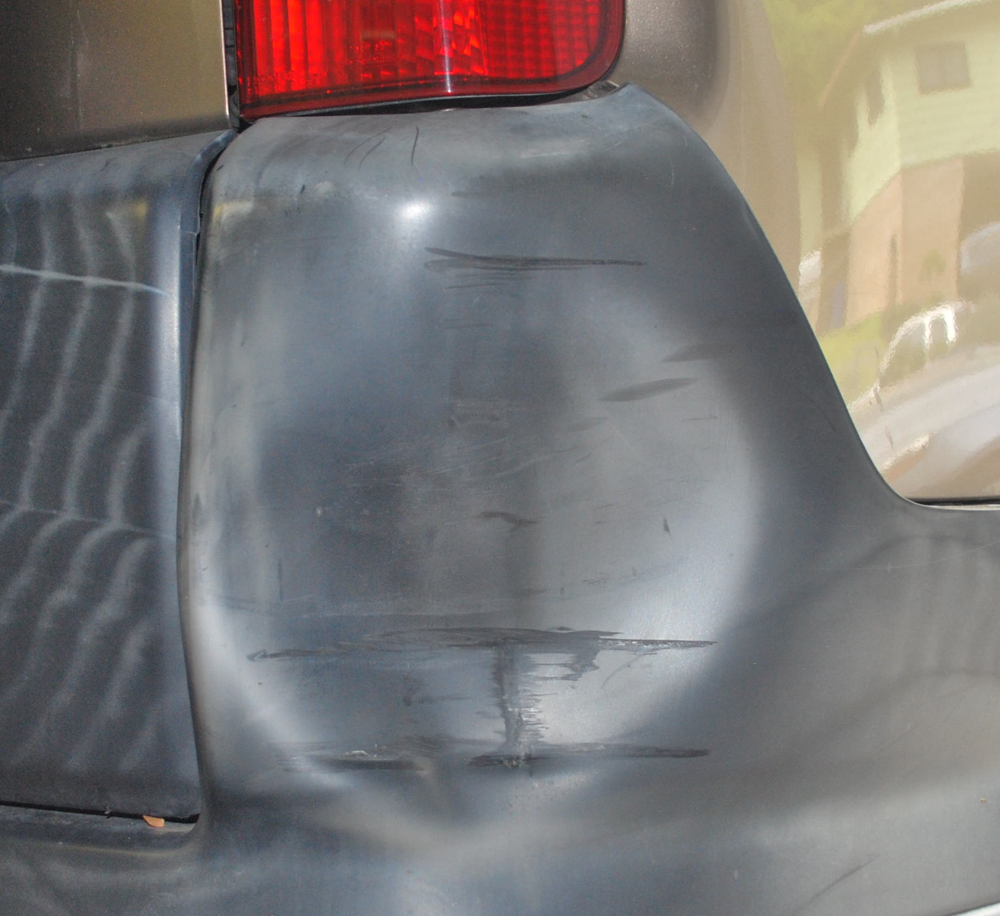

[[0.98643726 0.01109335]]
damaged


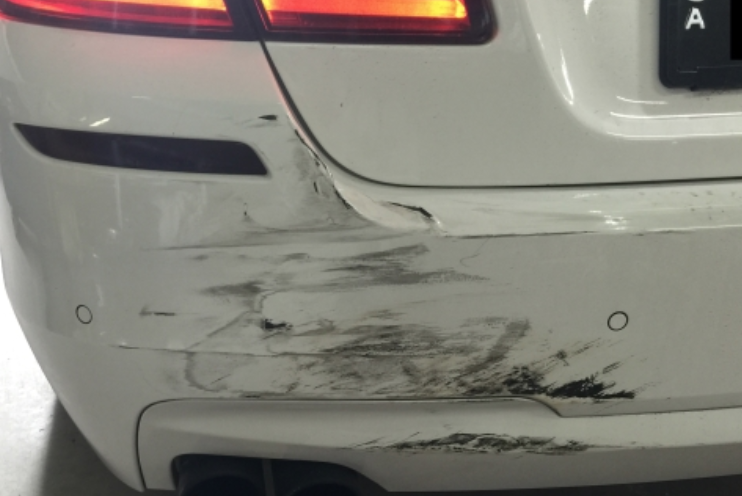

[[0.9535565  0.02614849]]
damaged


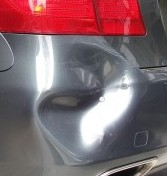

[[0.954763   0.06201201]]
damaged


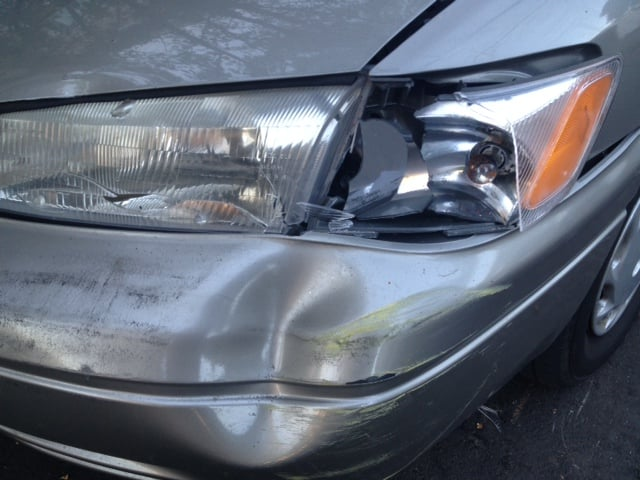

[[0.9944384  0.00737607]]
damaged


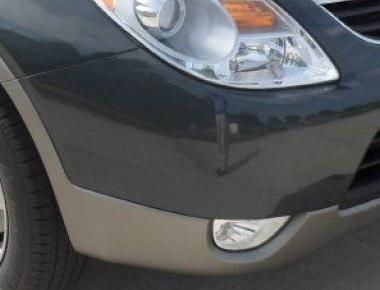

[[0.00899827 0.98695356]]
not


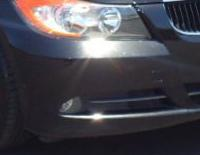

[[0.0034642  0.99633455]]
not


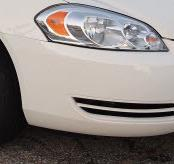

[[0.08534875 0.9229777 ]]
not


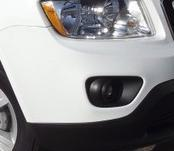

[[0.00177175 0.9976527 ]]
not


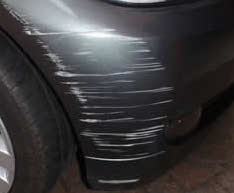

[[0.94216526 0.03814997]]
damaged


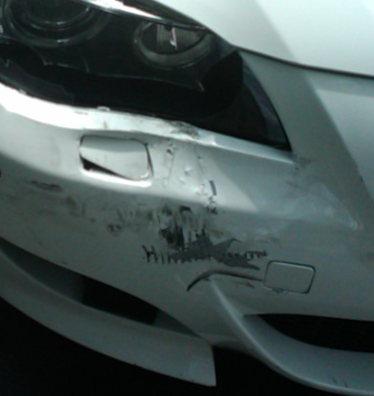

[[0.9855651  0.00787673]]
damaged


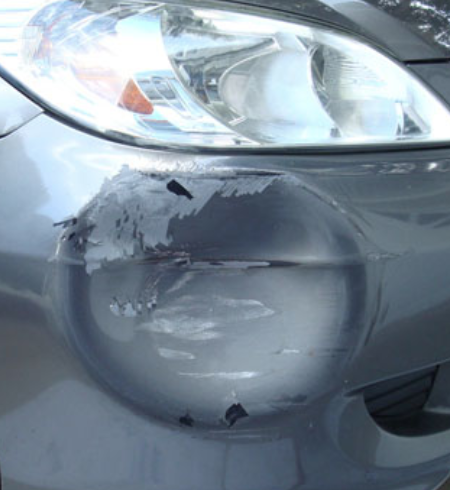

[[0.9963325  0.00310345]]
damaged


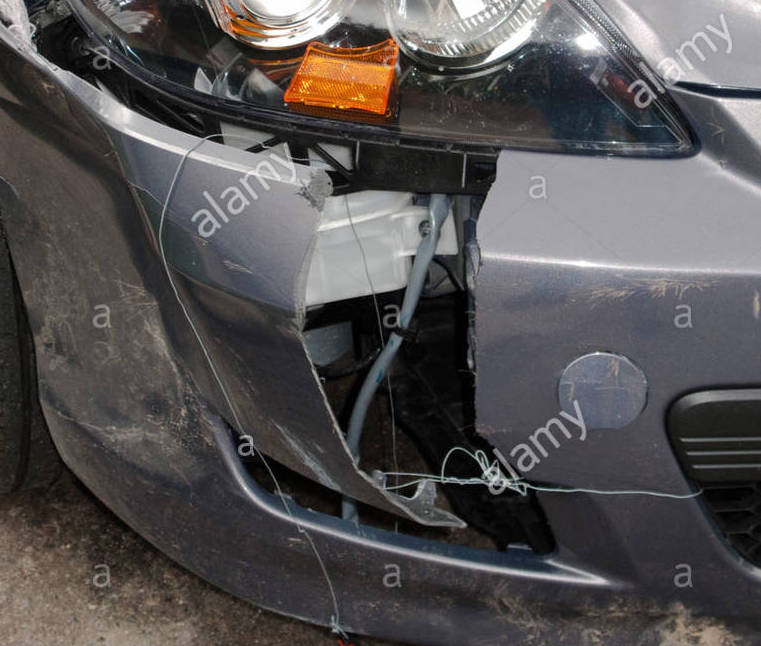

[[0.99462366 0.00440038]]
damaged


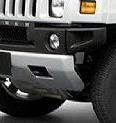

[[0.00805516 0.9973908 ]]
not


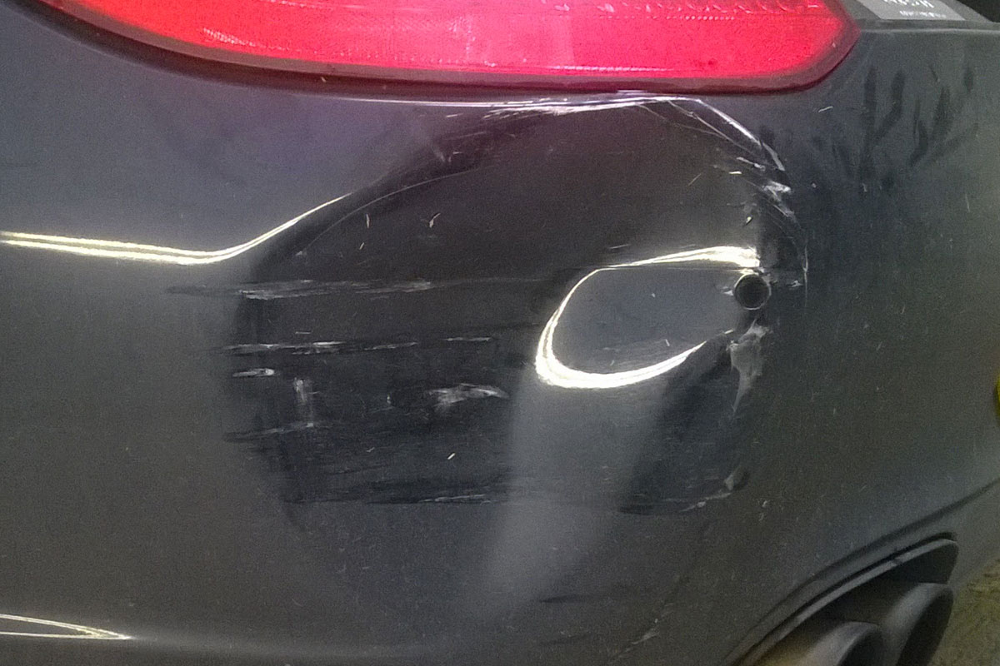

[[0.95724237 0.04351272]]
damaged


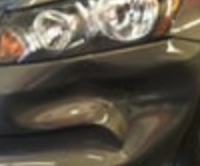

[[0.00811649 0.9939976 ]]
not


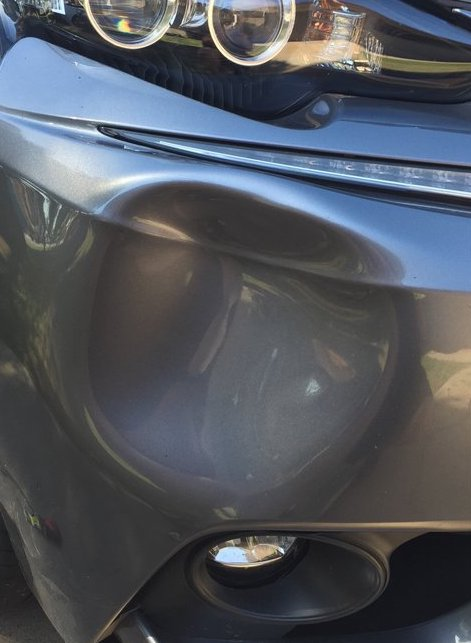

[[0.9441561  0.07036062]]
damaged


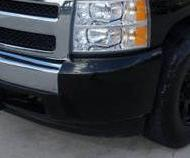

[[0.01151716 0.988967  ]]
not


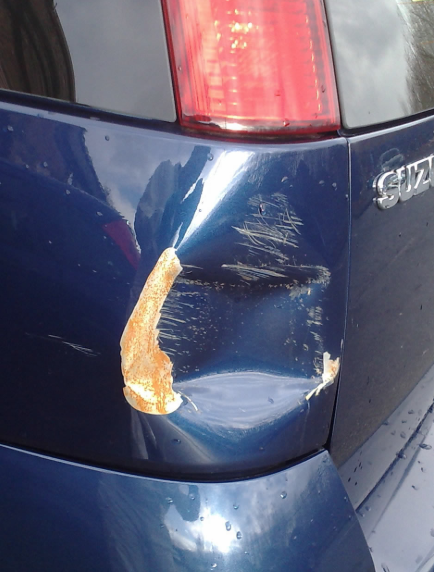

[[0.988622   0.01032239]]
damaged


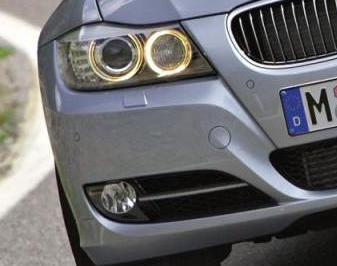

[[0.00738895 0.9926804 ]]
not


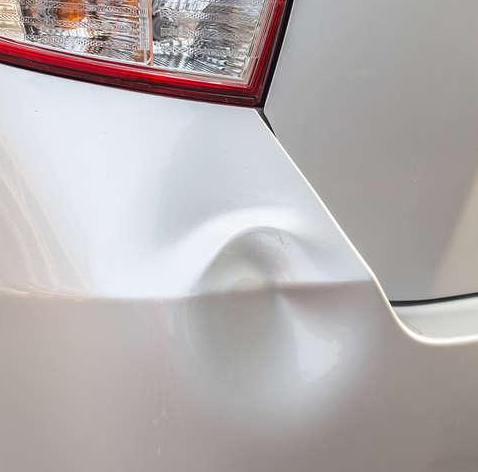

[[0.90156925 0.09136853]]
damaged


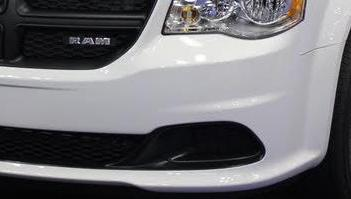

[[0.01725867 0.97404003]]
not


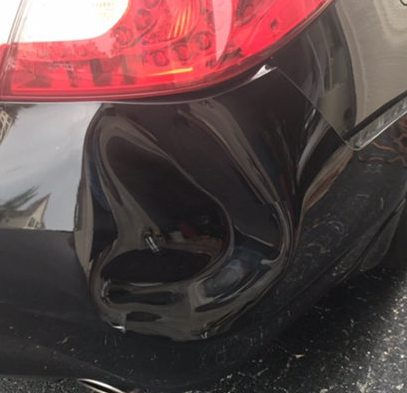

[[0.9724725  0.02607024]]
damaged


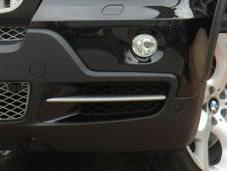

[[0.00839671 0.9944812 ]]
not


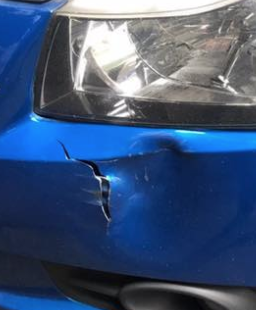

[[0.95608354 0.06319458]]
damaged


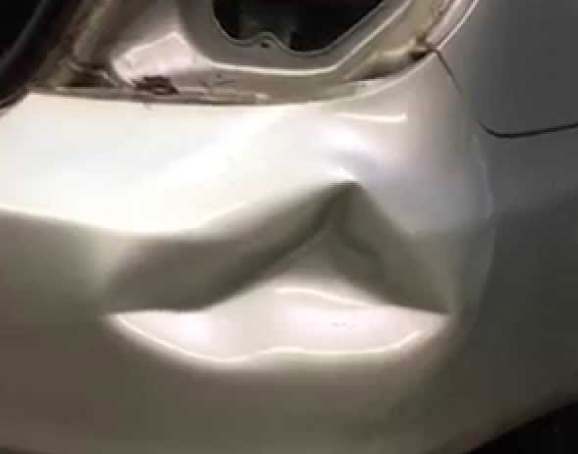

[[0.88032204 0.08130665]]
damaged


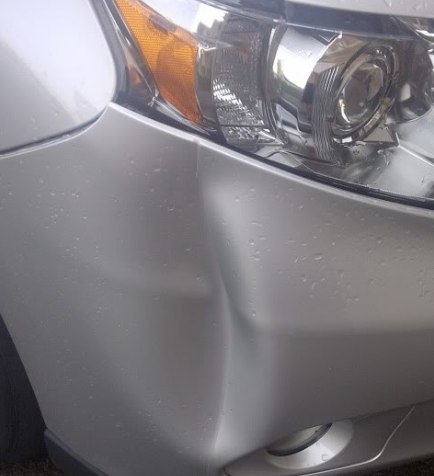

[[0.6971624 0.296805 ]]
damaged


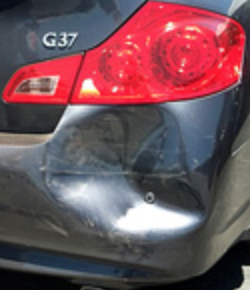

[[0.9453854 0.0513011]]
damaged


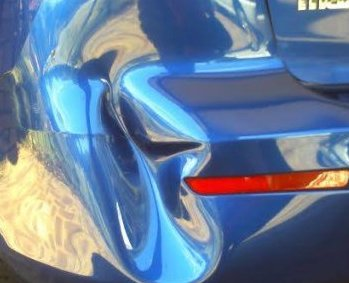

[[0.6666411  0.29941246]]
damaged


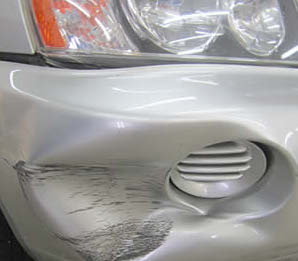

[[0.8950955  0.10862998]]
damaged


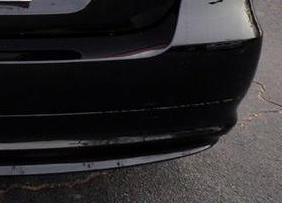

[[0.41942814 0.56849265]]
not


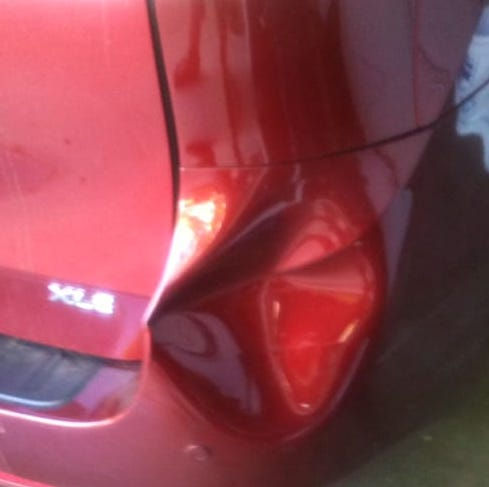

[[0.9161485  0.08386578]]
damaged


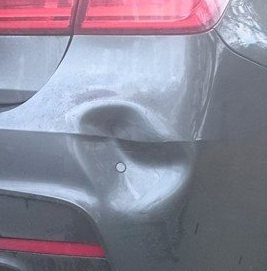

[[0.95962906 0.0472896 ]]
damaged


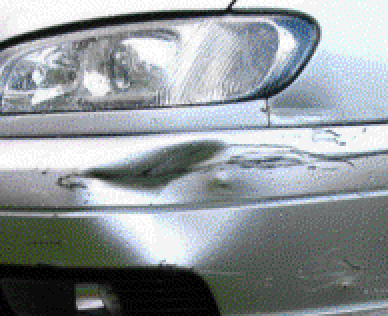

[[0.9779067  0.02199348]]
damaged


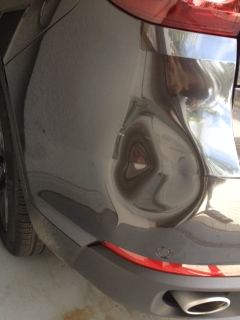

[[0.92743206 0.06224813]]
damaged


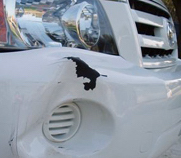

[[0.66589046 0.31202295]]
damaged


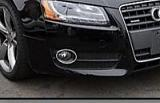

[[0.00123989 0.9985391 ]]
not


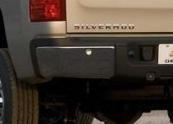

[[0.02736057 0.96536183]]
not


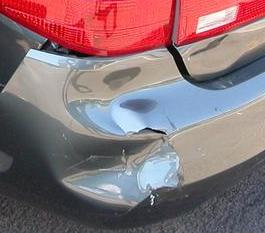

[[0.96085995 0.04718251]]
damaged


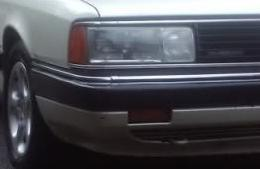

[[0.01850509 0.97487473]]
not


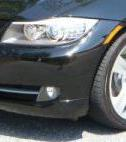

[[0.01904428 0.9827193 ]]
not


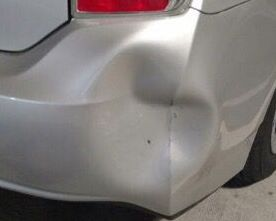

[[0.9658602  0.02497453]]
damaged


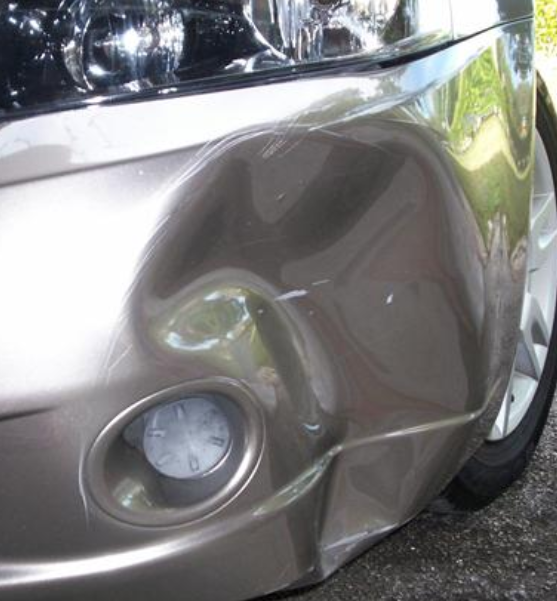

[[0.94197345 0.06180076]]
damaged


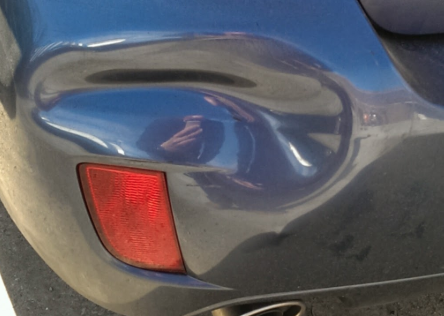

[[0.9142043  0.08268633]]
damaged


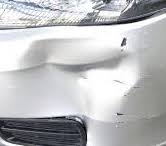

[[0.9706782  0.02728821]]
damaged


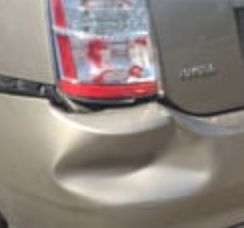

[[0.48088259 0.4570379 ]]
damaged


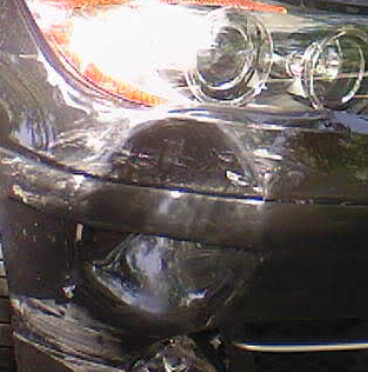

[[0.99357855 0.00462988]]
damaged


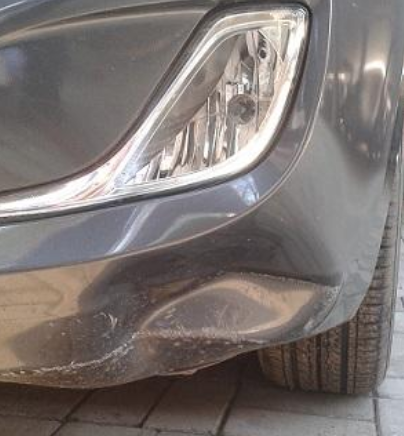

[[0.8614448  0.14942454]]
damaged


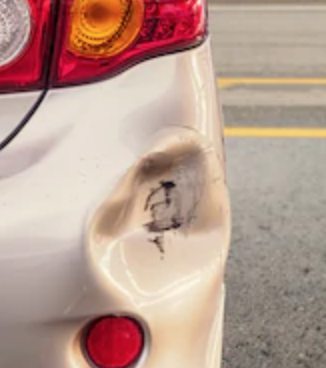

[[0.9774999  0.02372459]]
damaged


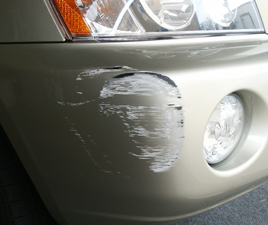

[[0.9610407  0.03980391]]
damaged


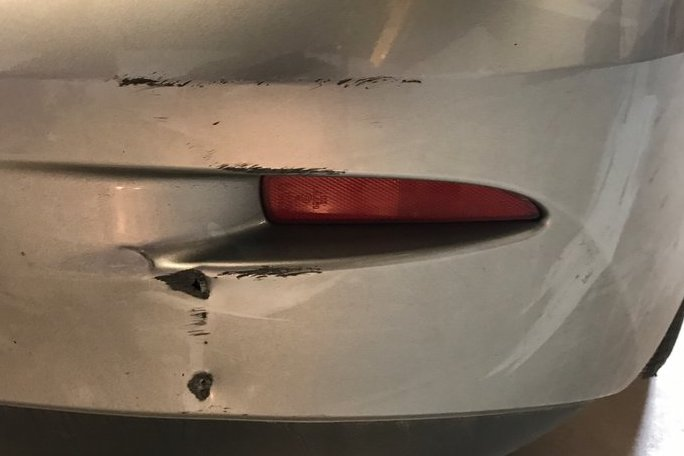

[[0.91021365 0.06892297]]
damaged


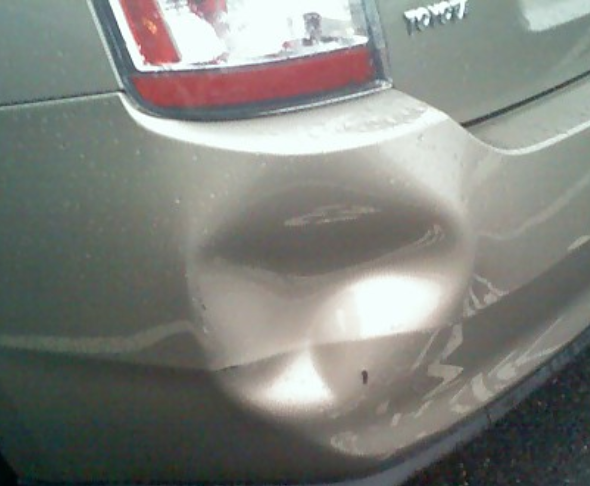

[[0.17922881 0.8233262 ]]
not


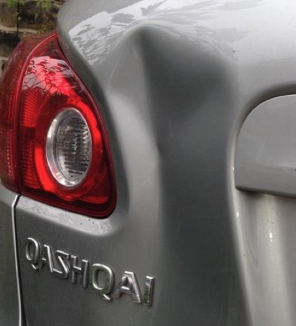

[[0.30811238 0.68376523]]
not


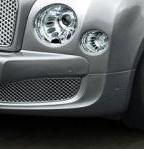

[[0.01252534 0.988487  ]]
not


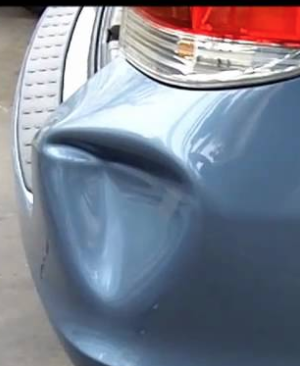

[[0.90524507 0.06265435]]
damaged


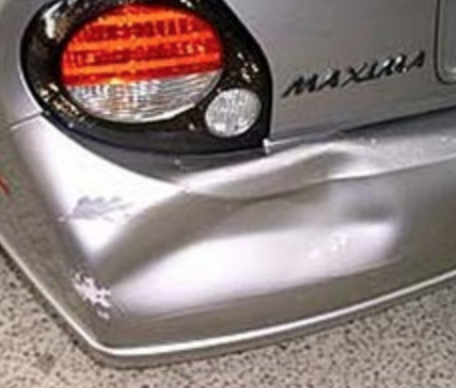

[[0.57436186 0.42397442]]
damaged


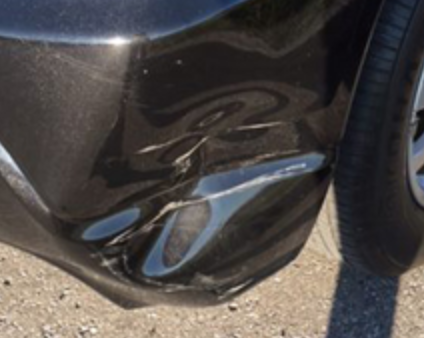

[[0.95352787 0.0406816 ]]
damaged


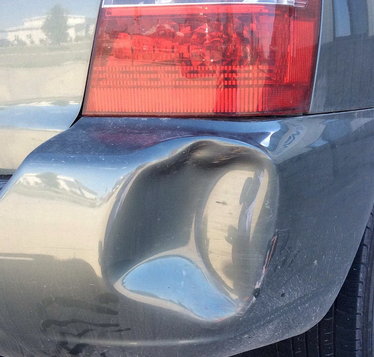

[[0.987755   0.01279344]]
damaged


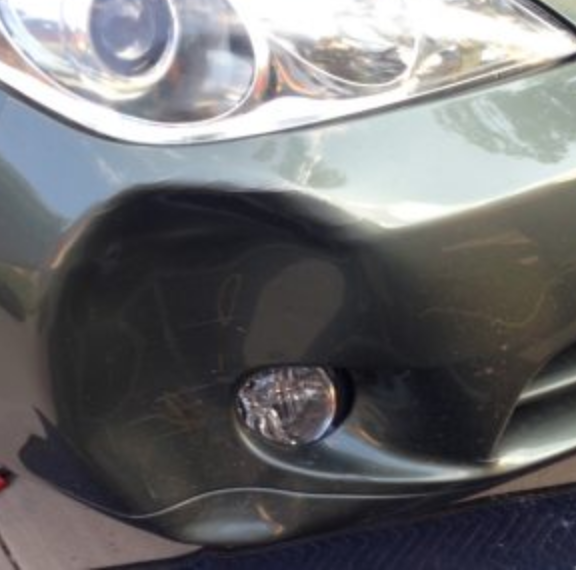

[[0.32410753 0.7571985 ]]
not


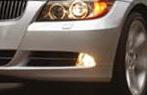

[[0.00149089 0.99856585]]
not


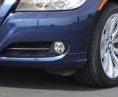

[[0.00142986 0.999106  ]]
not


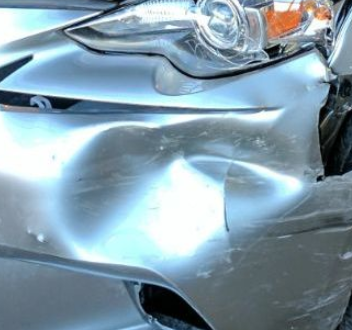

[[0.9864107 0.0175156]]
damaged


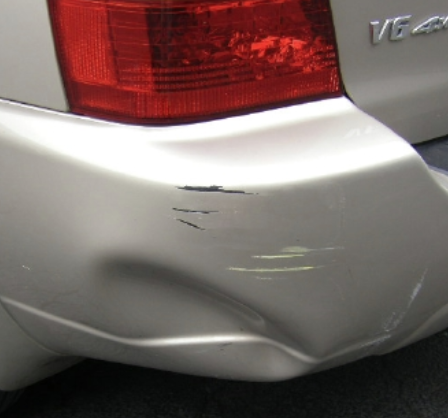

[[0.9782234  0.01854564]]
damaged


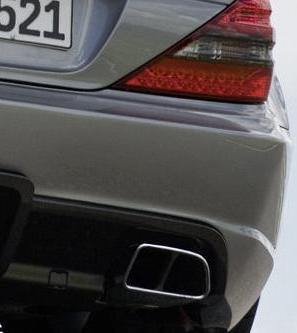

[[0.02389531 0.97753227]]
not


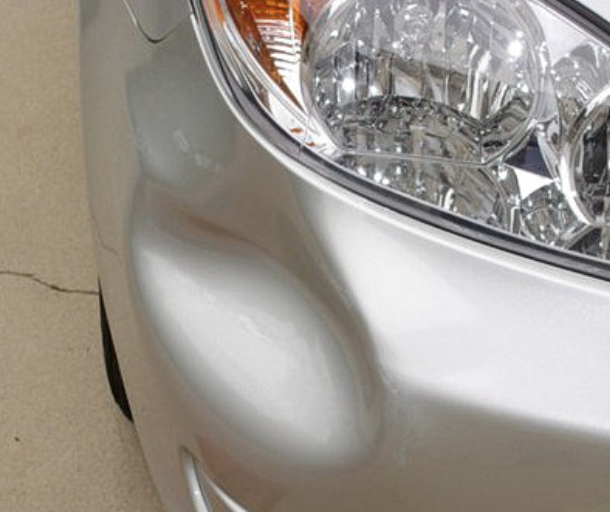

[[0.9688428  0.01934118]]
damaged


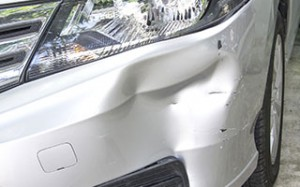

[[0.98204285 0.01861947]]
damaged


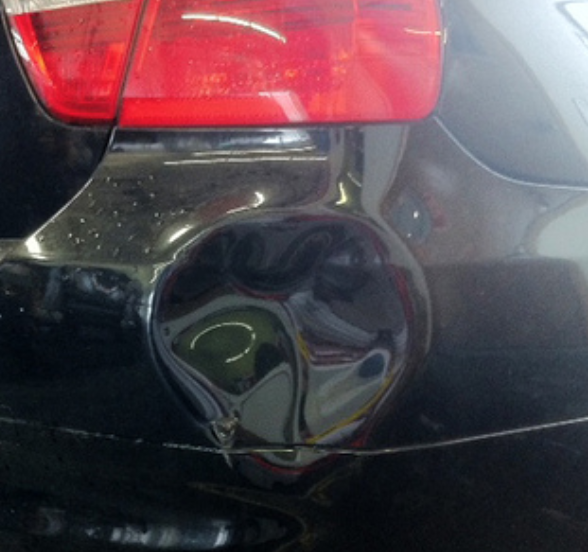

[[0.93950933 0.07854083]]
damaged


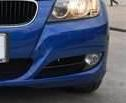

[[0.00900602 0.99251336]]
not


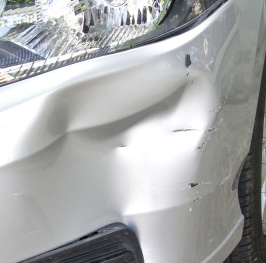

[[0.97812426 0.02170029]]
damaged


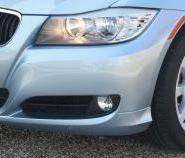

[[0.01750112 0.9884548 ]]
not


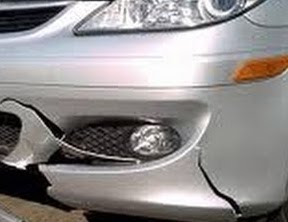

[[0.02724353 0.97573936]]
not


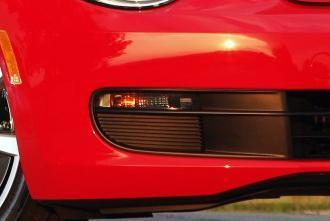

[[0.05020955 0.9330807 ]]
not


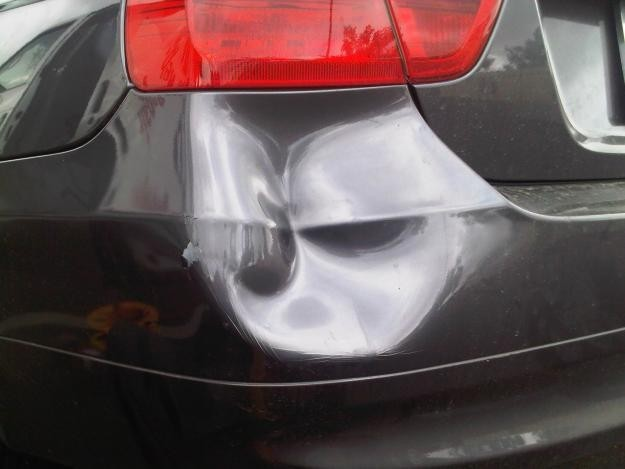

[[0.97752917 0.02435748]]
damaged


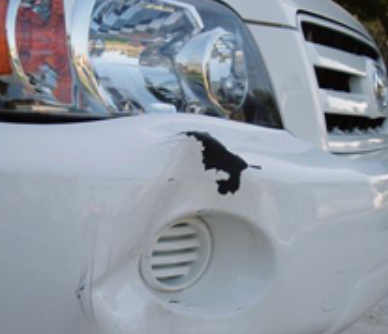

[[0.8325953  0.13304654]]
damaged


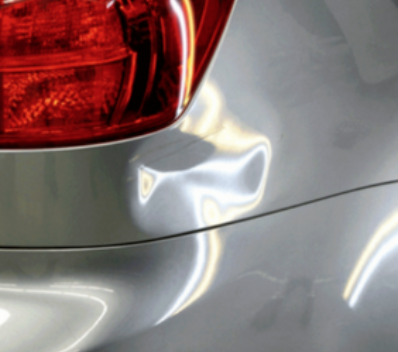

[[0.53114474 0.49961632]]
damaged


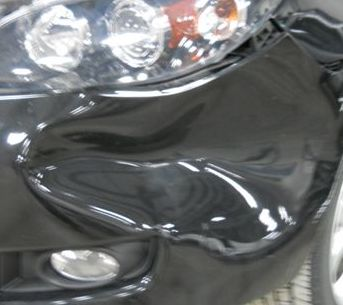

[[0.75826186 0.21721885]]
damaged


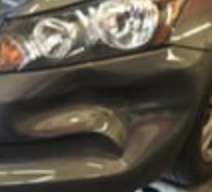

[[0.00665433 0.9941419 ]]
not


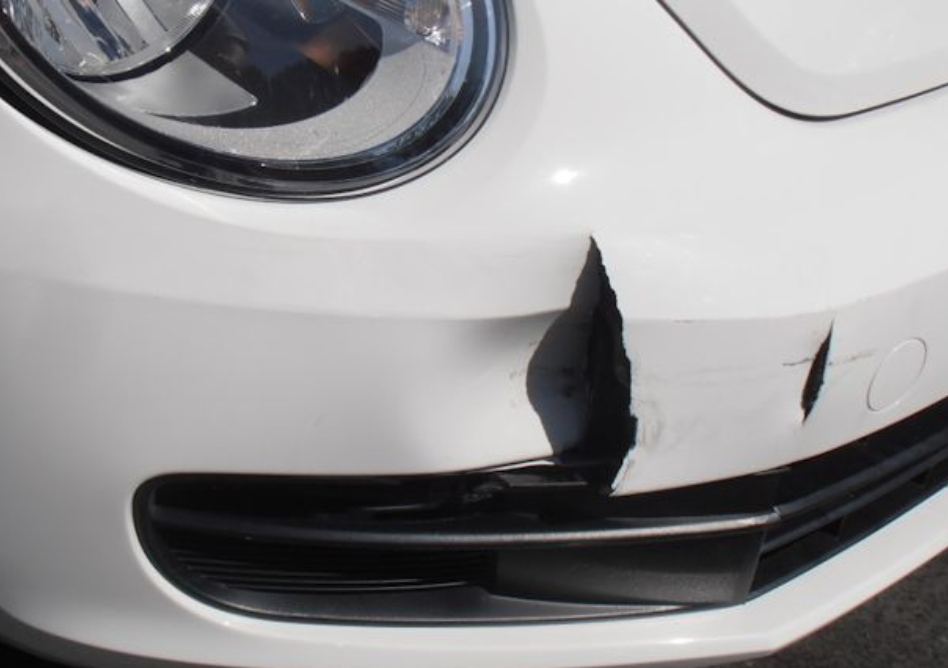

[[0.5794599  0.44100535]]
damaged


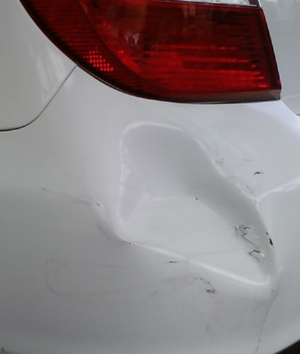

[[0.9457301  0.03584059]]
damaged
skipping .DS_Store


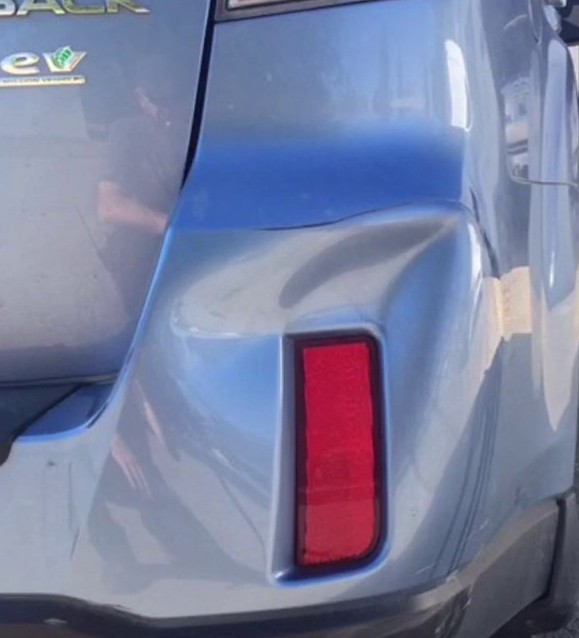

[[0.45529184 0.5057085 ]]
not


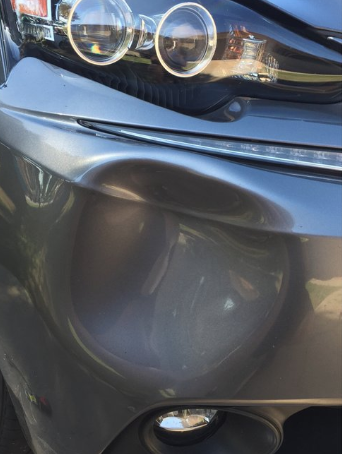

[[0.9101991  0.09213037]]
damaged


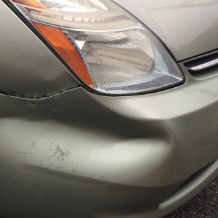

[[0.6624805 0.3592025]]
damaged


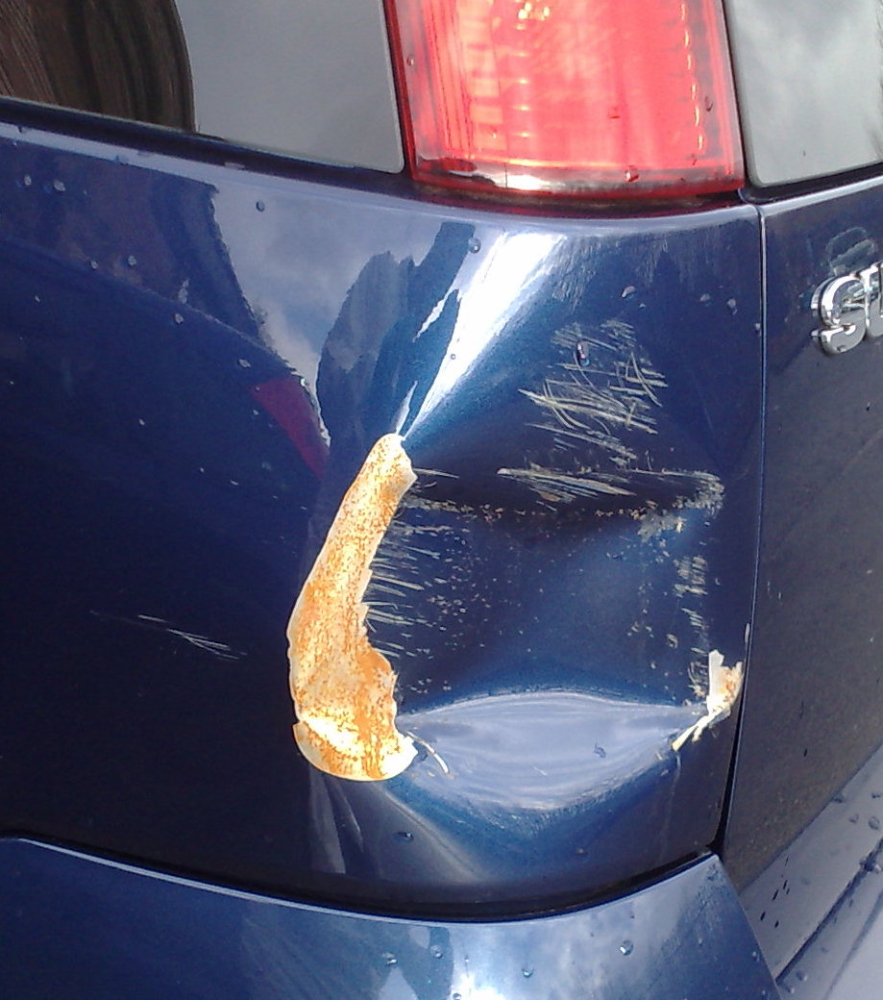

[[0.993654   0.00553575]]
damaged


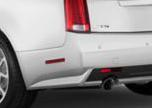

[[0.00872732 0.98896676]]
not


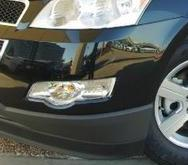

[[0.17730312 0.7812495 ]]
not


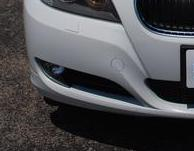

[[0.45022202 0.3546436 ]]
damaged


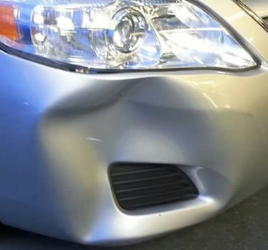

[[0.41862905 0.4654895 ]]
not


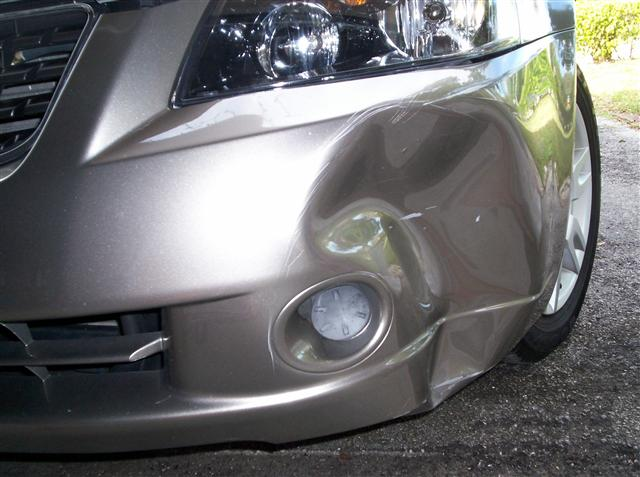

[[0.92072433 0.1130185 ]]
damaged


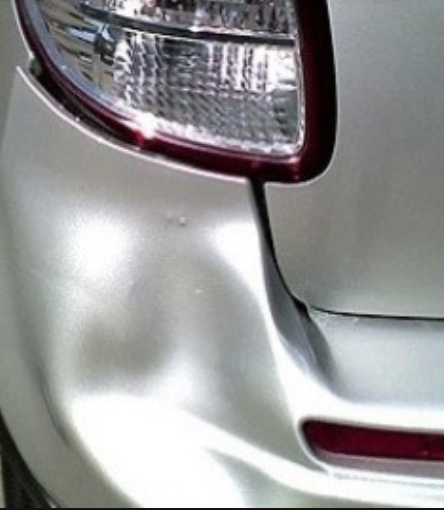

[[0.93383676 0.05569891]]
damaged


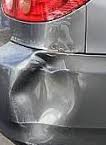

[[0.98995334 0.00889296]]
damaged


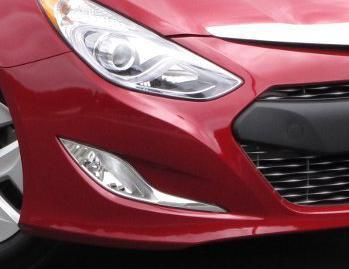

[[0.05556362 0.95522976]]
not


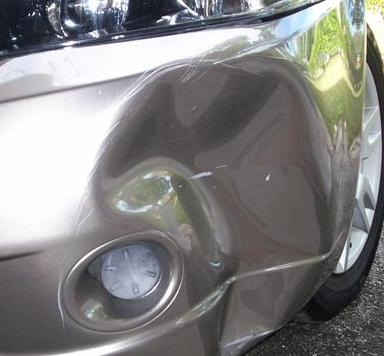

[[0.9556139  0.04443916]]
damaged


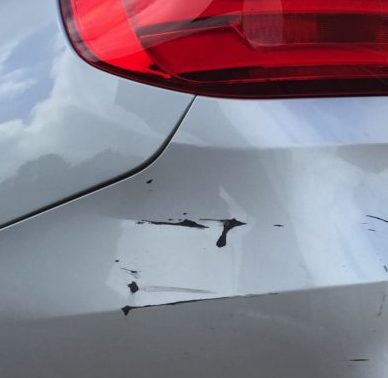

[[0.9820478 0.0109732]]
damaged


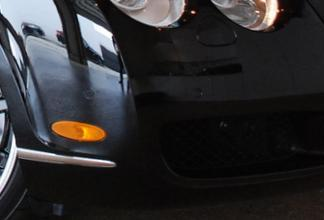

[[0.01840846 0.97663295]]
not


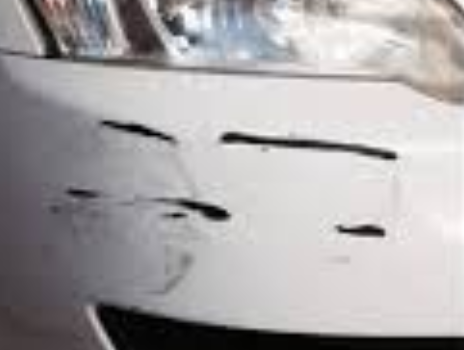

[[0.5643503  0.39682105]]
damaged


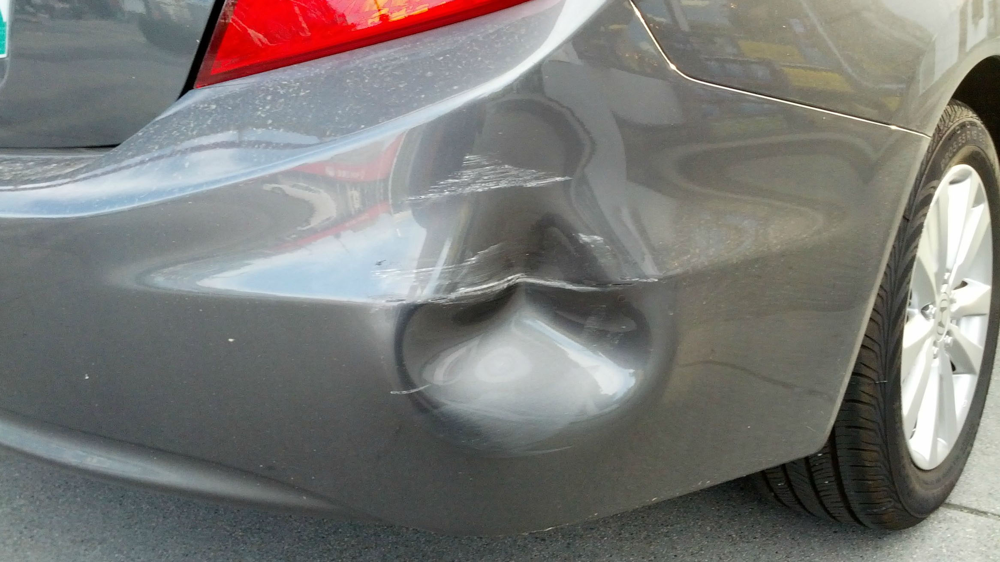

[[0.9919007  0.00543176]]
damaged


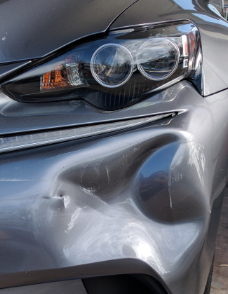

[[0.6772943  0.45734304]]
damaged


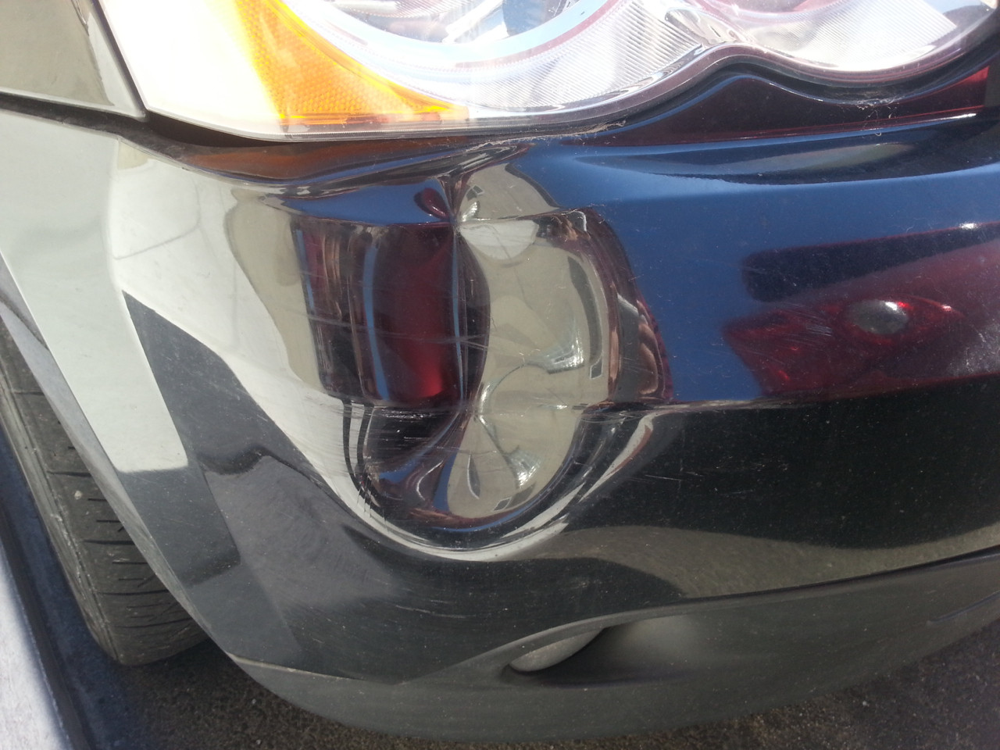

[[0.98242205 0.01830537]]
damaged


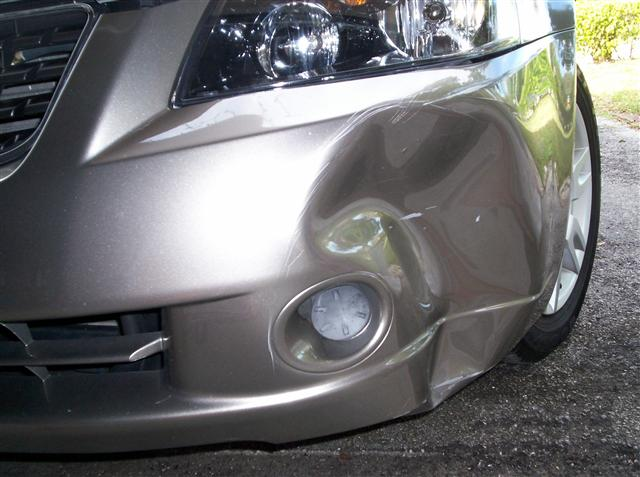

[[0.92072433 0.1130185 ]]
damaged


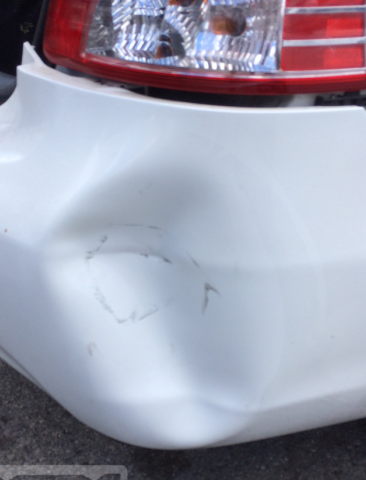

[[0.9584929  0.02856063]]
damaged


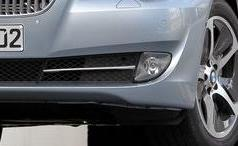

[[0.00454868 0.9959552 ]]
not


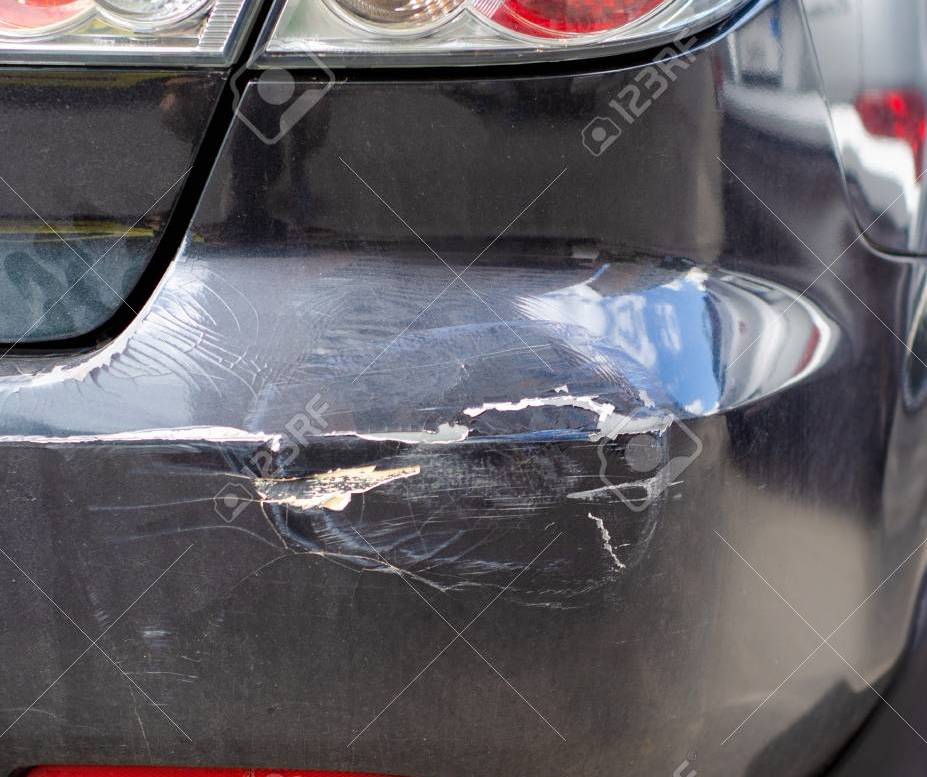

[[0.99473804 0.00856324]]
damaged


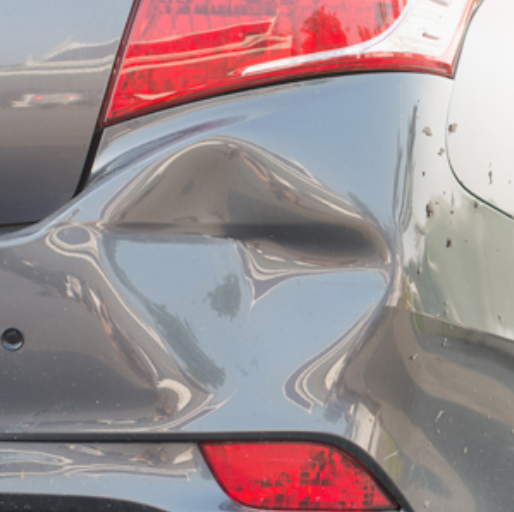

[[0.9805895 0.0230492]]
damaged


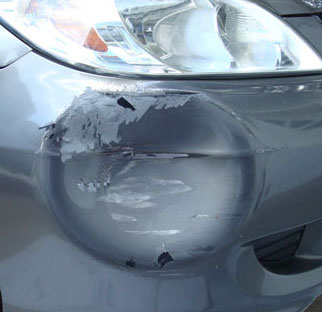

[[0.9964477 0.0032011]]
damaged


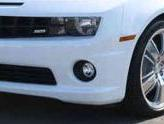

[[0.00330696 0.9982951 ]]
not


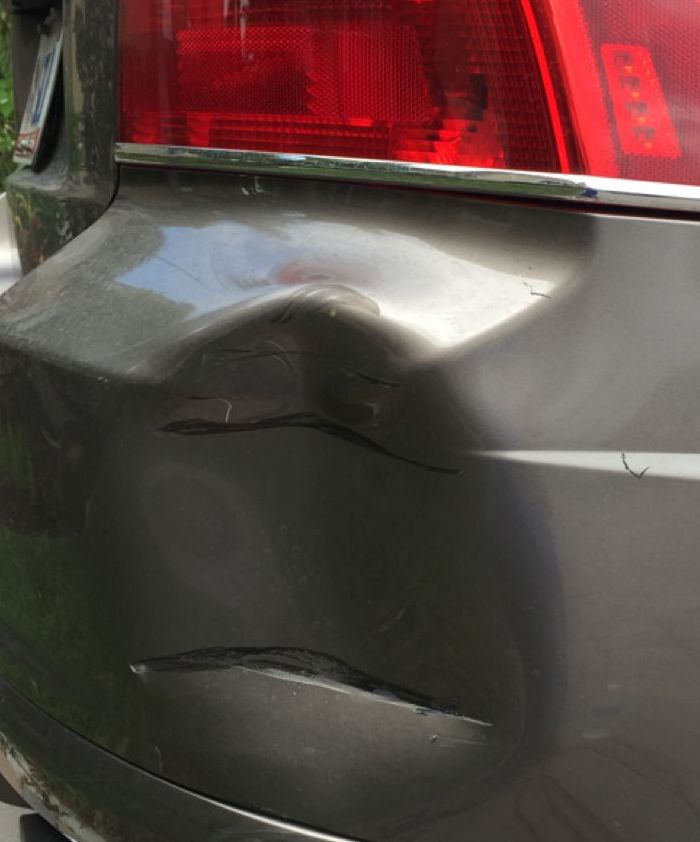

[[0.9276867  0.07081717]]
damaged


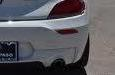

[[0.43965912 0.56195074]]
not


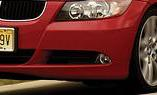

[[0.0014476  0.99920887]]
not


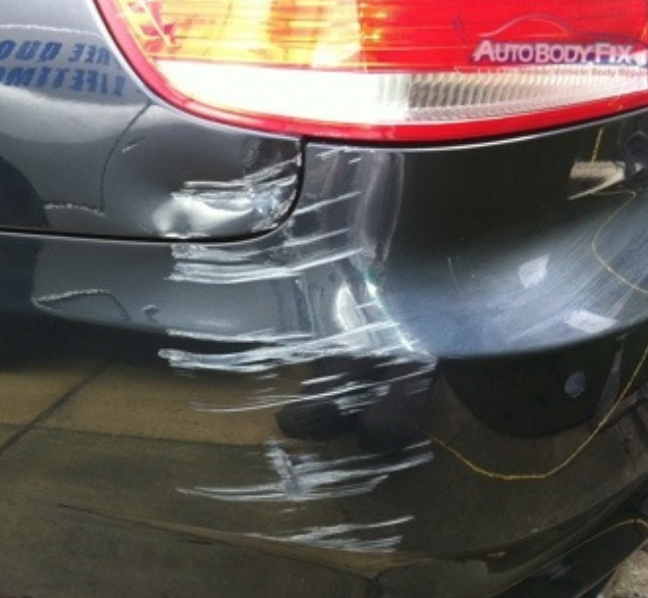

[[0.9455349  0.04545295]]
damaged


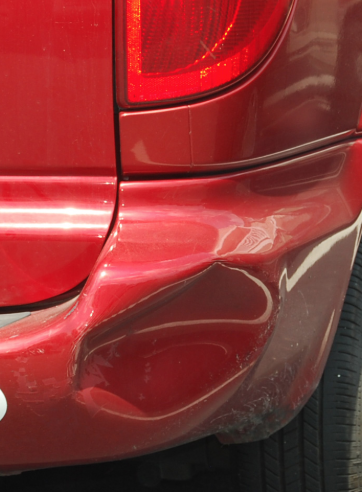

[[0.17015107 0.84317327]]
not


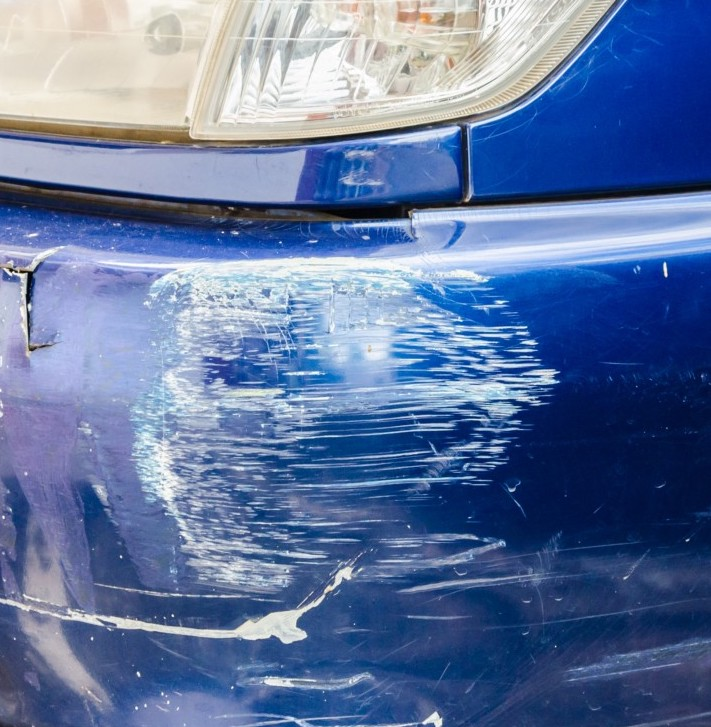

[[0.99207604 0.00895057]]
damaged


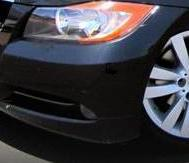

[[0.00732942 0.99337184]]
not


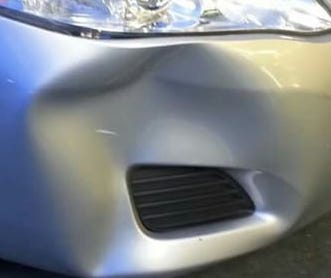

[[0.4900275 0.3850499]]
damaged


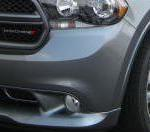

[[0.0039812 0.9960542]]
not


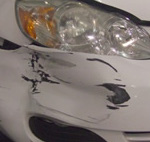

[[0.973708   0.02651089]]
damaged


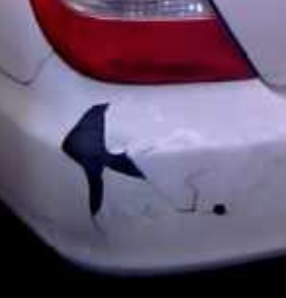

[[0.71070755 0.21721214]]
damaged


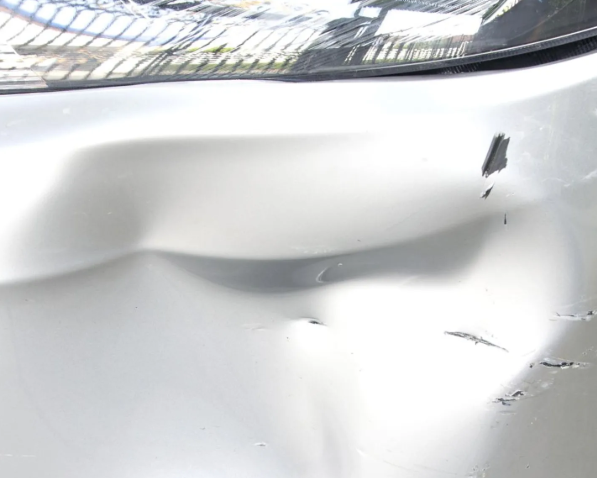

[[0.98356265 0.01535607]]
damaged


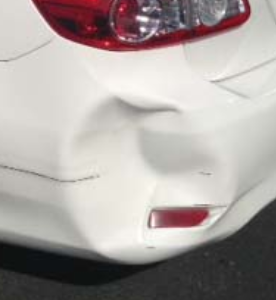

[[0.770447   0.16473992]]
damaged
122


In [0]:
from IPython.display import Image, display
import os
from keras.models import load_model
import cv2
import numpy as np

model = load_model("/content/model2.h5")
dirname = "/content/Damaged-or-not-v1/Test/"
#dirname = "/content/Non-damaged Bumpers/"
correct = 0
incorrect = 0
total = 0

for file in os.listdir(dirname):
#   print(file)
#   display(Image(dirname + file, width=100, height=100))
  img = cv2.imread(dirname + file)
  
  if(img is None):
    print("skipping", file)
    continue
  img = img/255
  img = cv2.resize(img,(150,150))
  img_tensor = np.reshape(img,[1, 150,150,3])
  
 
  prediction = model.predict(img_tensor)
  display(Image(dirname + file, width=100, height=100))
  print(prediction)
  if prediction[0][0] > prediction[0][1]:
    print("damaged")
  else:
    print("not")
  total += 1
#   for i, predicted in enumerate(prediction):
#     if predicted[1] > predicted[0]:
#         print(predicted[1])
#         correct += 1
#         total += 1
#     else:
#         display(Image(dirname + file, width=100, height=100))
#         print(predicted[0])
#         incorrect += 1
#         total += 1

# print((correct/total)*100)
# print(correct, total)

print(total)
  

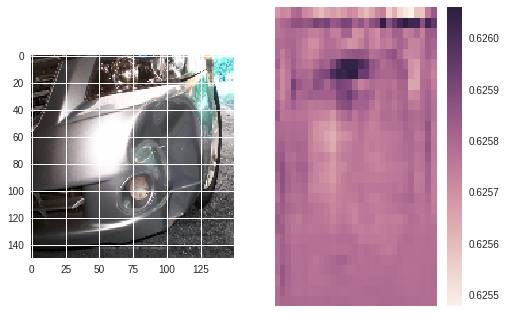

Object index is [0]


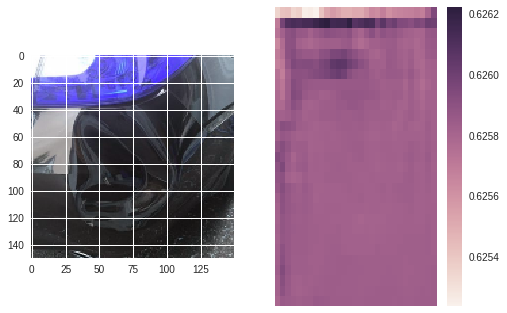

Object index is [0]


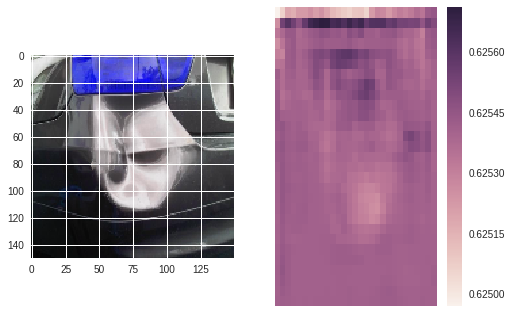

Object index is [0]


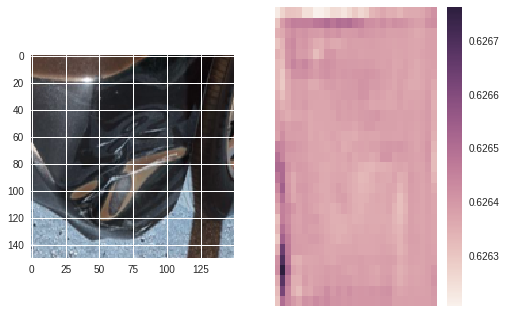

Object index is [0]


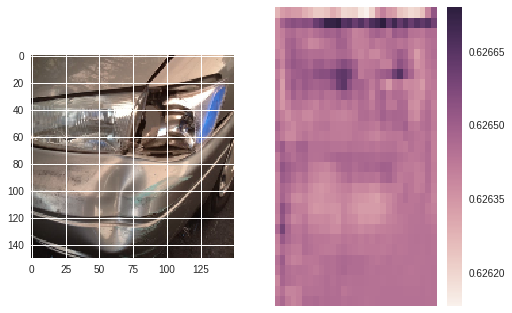

Object index is [0]


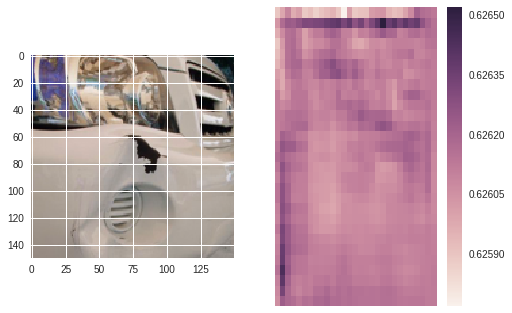

Object index is [0]
skipping
skipping


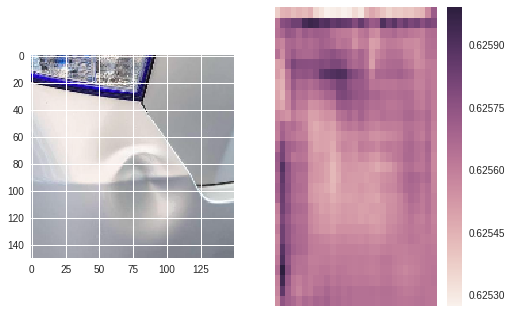

Object index is [0]


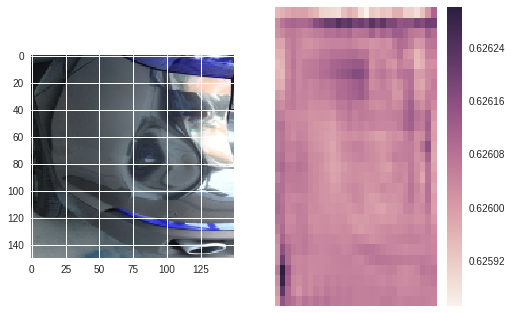

Object index is [0]
skipping


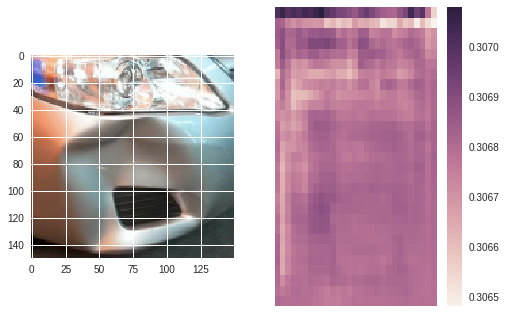

Object index is [1]


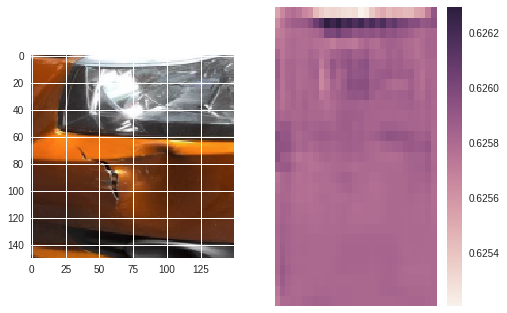

Object index is [0]


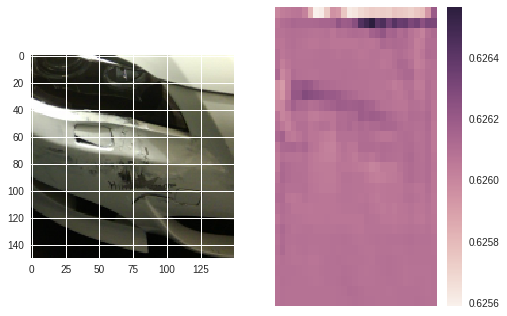

Object index is [0]


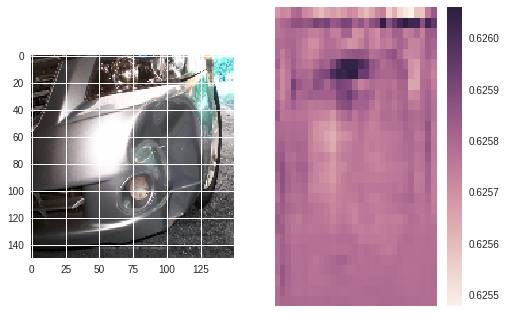

Object index is [0]


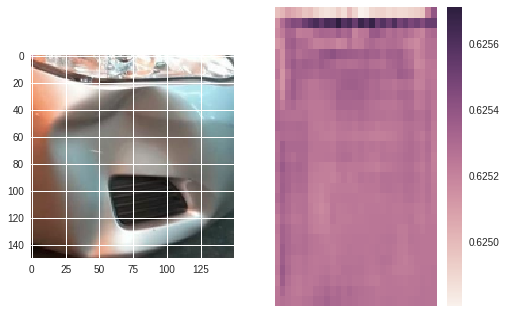

Object index is [0]
skipping
skipping


In [0]:
from keras.models import load_model
import numpy as np
import cv2
import math
import copy
import pylab
import seaborn as sns
import matplotlib.pyplot as plt

def Occlusion_exp(image_path, occluding_size, occluding_pixel, occluding_stride):
    
    img = cv2.imread(image_path)
    if(img is None):
      print("skipping")
      return
    img = img/255
    img = cv2.resize(img,(150,150))
    img_tensor = np.reshape(img,[1, 150,150,3])
    out = model.predict(img_tensor)
    out = out[0]
    # Getting the index of the winning class:
    m = max(out)
    index_object = [i for i, j in enumerate(out) if j == m]
    height, width, _ = img.shape
    output_height = int(math.ceil((height-occluding_size) / occluding_stride + 1))
    output_width = int(math.ceil((width-occluding_size) / occluding_stride + 1))
    heatmap = np.zeros((output_height, output_width))
    
    for h in range(output_height):
        for w in range(output_width):
            # Occluder region:
            h_start = h * occluding_stride
            w_start = w * occluding_stride
            h_end = min(height, h_start + occluding_size)
            w_end = min(width, w_start + occluding_size)
            # Getting the image copy, applying the occluding window and classifying it again:
            input_image = copy.copy(img)
            input_image[h_start:h_end, w_start:w_end,:] =  occluding_pixel            
            heatmap_img = input_image/255
            heatmap_img = cv2.resize(heatmap_img,(150,150))
            img_tensor = np.reshape(heatmap_img,[1, 150,150,3])
            out = model.predict(img_tensor)
            out = out[0]
#             print('scanning position (%s, %s)'%(h,w))
            # It's possible to evaluate the VGG-16 sensitivity to a specific object.
            # To do so, you have to change the variable "index_object" by the index of
            # the class of interest. The VGG-16 output indices can be found here:
            # https://github.com/HoldenCaulfieldRye/caffe/blob/master/data/ilsvrc12/synset_words.txt
            prob = (out[index_object]) 
            heatmap[h,w] = prob
    
    f = pylab.figure()
    f.add_subplot(1, 2, 2)  # this line outputs images side-by-side    
    ax = sns.heatmap(heatmap,xticklabels=False, yticklabels=False)
    f.add_subplot(1, 2, 1)
    plt.imshow(img)
    plt.show()
    print ( 'Object index is %s'%index_object)

model = load_model("/content/model2.h5")
for i in range(102, 120):
  image_path = '/content/Damaged-or-not-v1/Test/'+str(i)+'.jpg'
  # Enter here the parameters of the occluding window:
  occluding_size = 10
  occluding_pixel = 0
  occluding_stride = 5
  Occlusion_exp(image_path, occluding_size, occluding_pixel, occluding_stride)